In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

from __future__ import division
from __future__ import print_function
from __future__ import absolute_import
from __future__ import unicode_literals  

import math
import copy
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn.linear_model as linear_model
import sklearn.preprocessing as preprocessing
import scipy
import scipy.linalg as slin
import scipy.sparse.linalg as sparselin
import scipy.sparse as sparse

sns.set(color_codes=True)

import sys
sys.path.append("C:/Tang/influence-release-master")  #设置自定义包的搜索路径
from load_vehicles import load_vehicles
from influence.image_utils import plot_flat_colorimage, plot_flat_colorgrad

Using TensorFlow backend.


In [14]:
#coding:utf-8
import matplotlib as mpl
mpl.rcParams['font.sans-serif'] = ['FangSong']
mpl.rcParams['axes.unicode_minus']=False

In [2]:
num_classes = 2
num_train_ex_per_class = 1000
num_test_ex_per_class = 300

model_name = 'carair_%s_%s' % (num_train_ex_per_class, num_test_ex_per_class)
image_data_sets = load_vehicles(
    num_train_ex_per_class=num_train_ex_per_class, 
    num_test_ex_per_class=num_test_ex_per_class)

X_train = image_data_sets.train.x
X_test = image_data_sets.test.x
Y_train = image_data_sets.train.labels * 2 - 1
Y_test = image_data_sets.test.labels * 2 - 1
del image_data_sets

Loading vehicles from disk...


In [20]:
features = np.load('output17/features.npz')
train_features = features['train_inception_features']
test_features = features['test_inception_features']

The test index now is 15. 
Test image:
1.0 1.3233535 0.9999771118164062


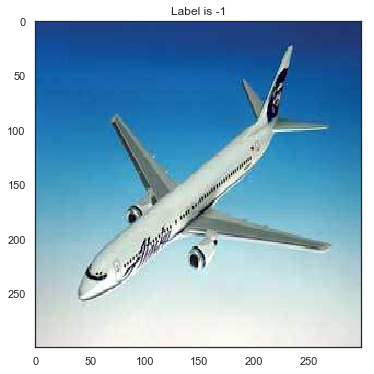

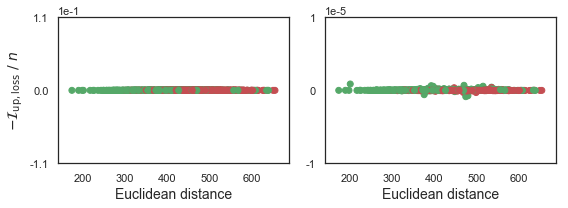

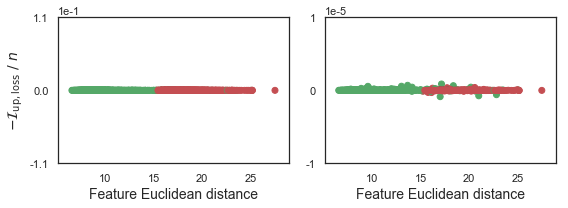

Top from RBF:
659 1.0 471.75412 0.95318365 0.0
658 1.0 366.26376 2.2150776 0.0
657 -1.0 480.57703 2.9128137 0.0
670 -1.0 496.84778 0.9999999 0.0
1999 -1.0 459.26953 0.661788 0.0


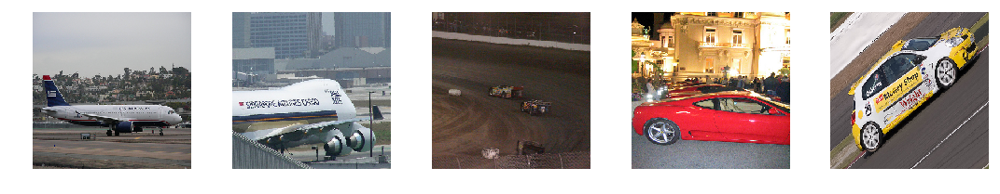

Top from Inception:
1824 1.0 398.19003 5.510699120350182e-07
1116 1.0 515.8646 5.666653160005808e-07
75 1.0 393.35446 6.413129740394652e-07
1707 1.0 470.8199 6.919431616552174e-07
902 1.0 202.03003 8.712140843272209e-07


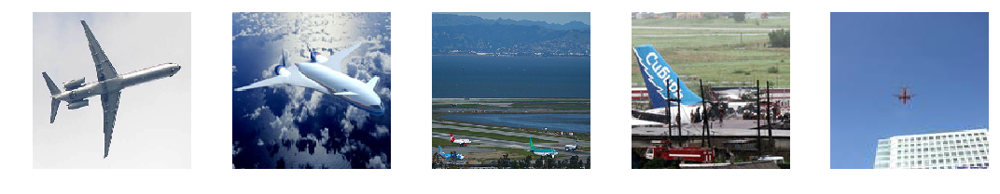

The test index now is 18. 
Test image:
1.0 0.65536606 0.9990612864494324


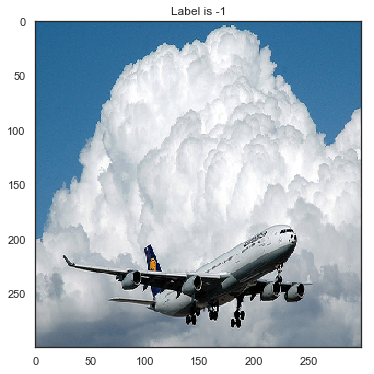

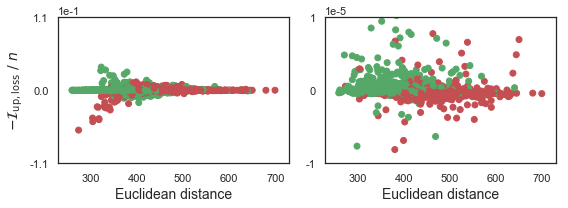

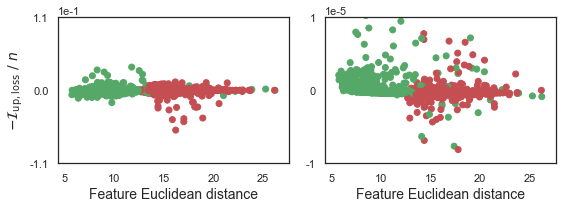

Top from RBF:
790 1.0 372.50327 0.83272135 0.02433287048339844
1923 1.0 378.33914 0.57995605 0.027607534408569338
505 1.0 321.46625 0.38527188 0.029745311737060548
433 1.0 331.8184 0.11117394 0.030761743545532228
1203 1.0 322.60742 0.7311891 0.035076332092285153


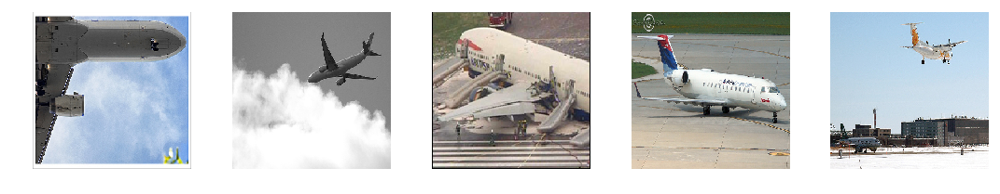

Top from Inception:
1116 1.0 408.51434 2.457648143172264e-05
1992 1.0 419.37915 2.5607071816921232e-05
1853 1.0 270.15063 2.728338912129402e-05
1654 1.0 401.59268 2.792387269437313e-05
500 1.0 446.2423 2.9320003464818002e-05


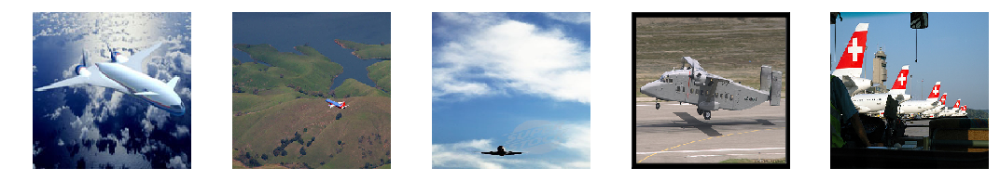

The test index now is 38. 
Test image:
-1.0 1.9090238 0.9980937838554382


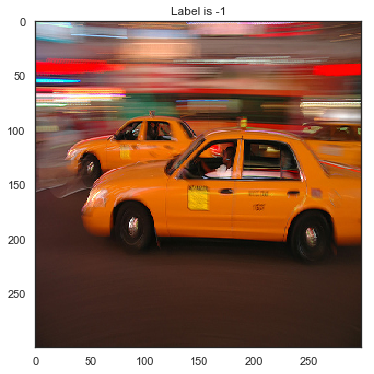

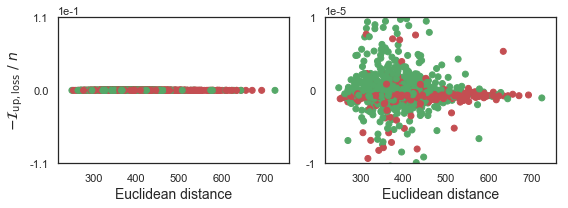

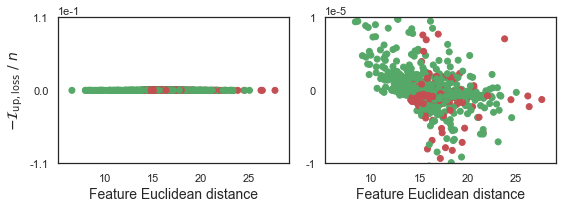

Top from RBF:
659 1.0 360.7333 0.95318365 0.0
658 1.0 380.54068 2.2150776 0.0
657 -1.0 279.00177 2.9128137 0.0
670 -1.0 409.92087 0.9999999 0.0
1999 -1.0 364.8954 0.661788 0.0


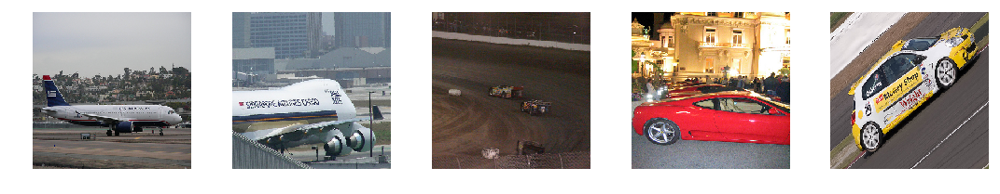

Top from Inception:
698 1.0 300.71375 5.3654849529266356e-05
1072 -1.0 352.48926 6.129010021686555e-05
871 -1.0 332.92932 6.91821351647377e-05
887 -1.0 396.11768 0.0001015251874923706
39 -1.0 351.751 0.00010322262346744538


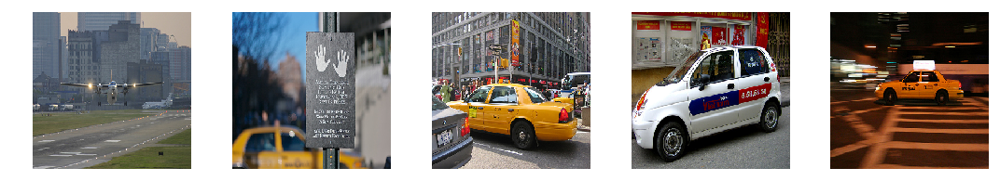

The test index now is 41. 
Test image:
1.0 1.6362476 0.9993579983711243


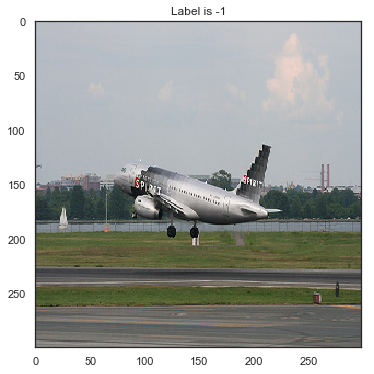

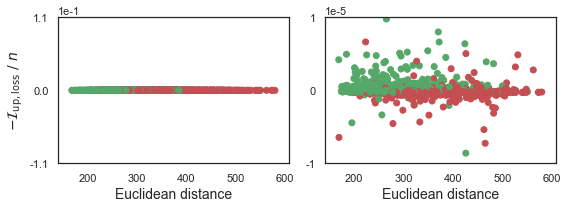

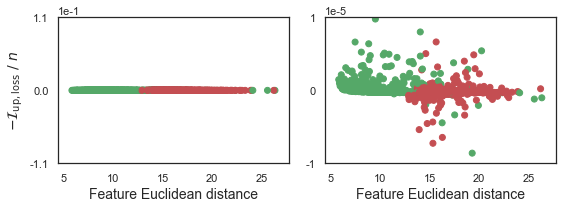

Top from RBF:
659 1.0 209.12651 0.95318365 0.0
658 1.0 294.09338 2.2150776 0.0
657 -1.0 411.5124 2.9128137 0.0
670 -1.0 331.0737 0.9999999 0.0
1999 -1.0 319.8447 0.661788 0.0


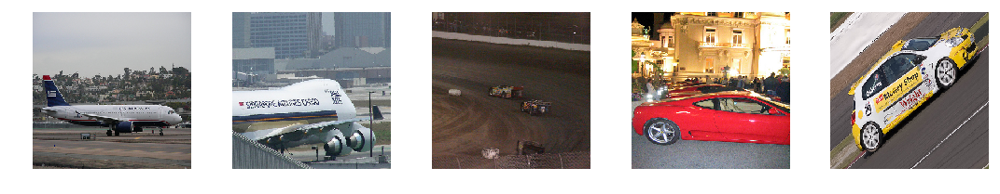

Top from Inception:
698 1.0 267.5308 1.606001891195774e-05
1116 1.0 254.76248 1.6782084479928017e-05
1681 1.0 191.81982 2.0148994401097297e-05
1992 1.0 318.5628 2.0896896719932556e-05
1654 1.0 377.25073 2.6270482689142227e-05


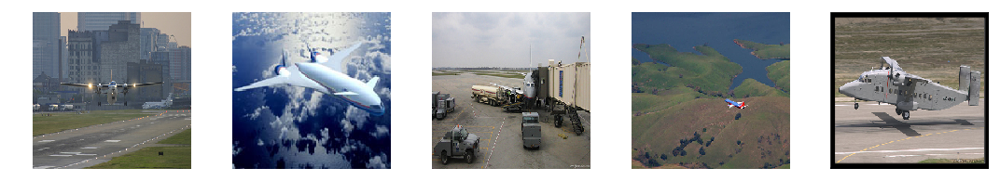

The test index now is 59. 
Test image:
1.0 1.4518135 0.999890923500061


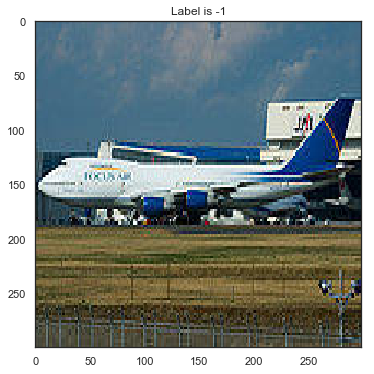

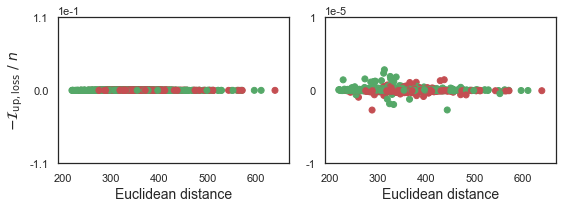

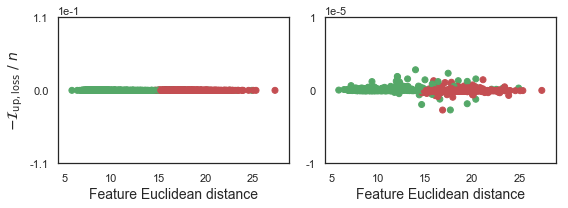

Top from RBF:
659 1.0 326.45782 0.95318365 0.0
658 1.0 301.65057 2.2150776 0.0
657 -1.0 294.84753 2.9128137 0.0
670 -1.0 398.6897 0.9999999 0.0
1999 -1.0 330.827 0.661788 0.0


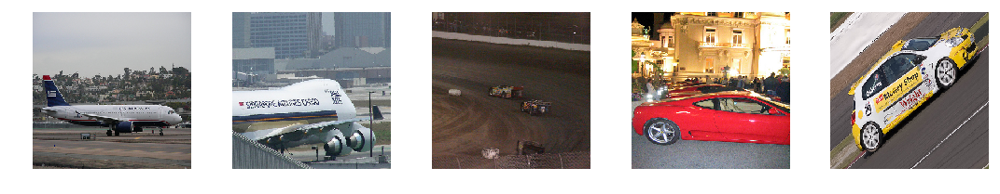

Top from Inception:
935 1.0 273.13406 1.5692934393882752e-06
1351 1.0 337.82455 1.8301605014130474e-06
300 1.0 325.63934 1.905841869302094e-06
958 1.0 311.91647 2.3478430230170488e-06
1707 1.0 313.46548 2.8232934419065713e-06


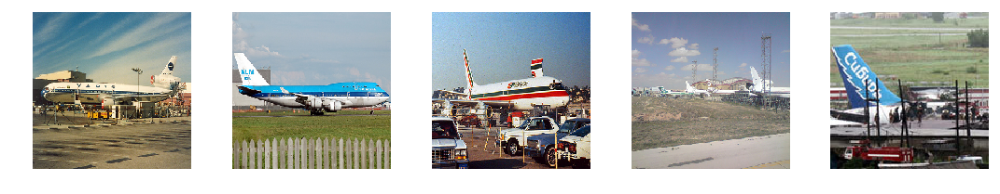

The test index now is 91. 
Test image:
-1.0 0.75105166 0.9978759288787842


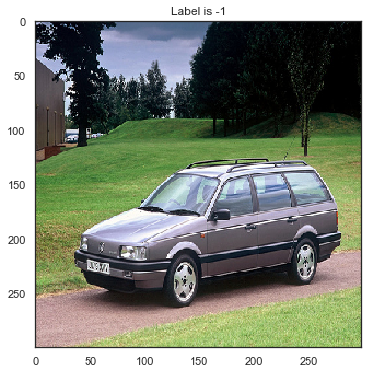

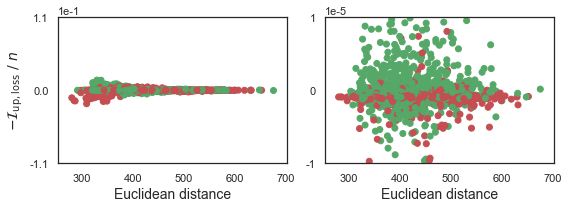

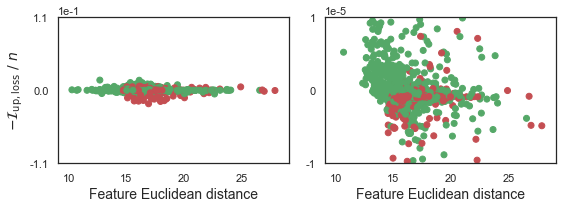

Top from RBF:
451 -1.0 367.78247 0.7721865 0.009972660064697266
401 -1.0 321.2349 -0.6263331 0.011635418891906738
1223 -1.0 325.78992 0.7896908 0.011764083862304688
1110 -1.0 337.55685 0.9076797 0.015250953674316406
1856 -1.0 329.51633 0.60793114 0.015483963966369628


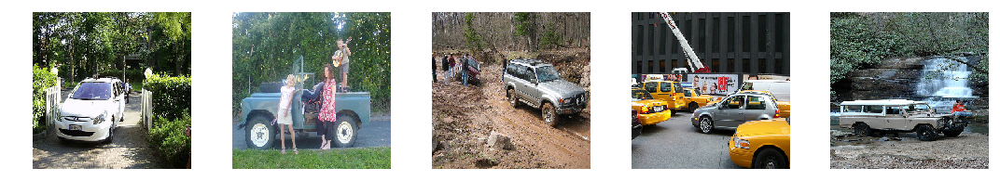

Top from Inception:
500 1.0 483.58527 5.2637103945016864e-05
75 1.0 363.29785 5.55371455848217e-05
1681 1.0 476.49405 5.9669259935617444e-05
382 -1.0 422.62933 6.056566908955574e-05
887 -1.0 367.93042 0.00013074220716953277


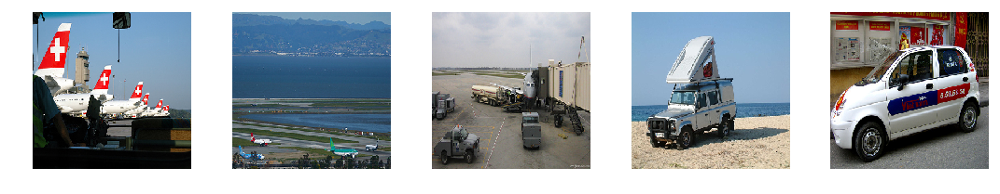

The test index now is 99. 
Test image:
-1.0 0.4813552 0.9997815489768982


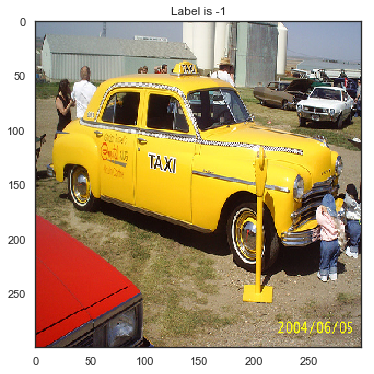

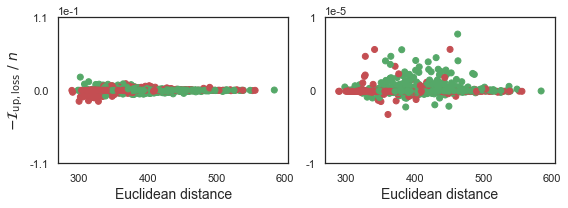

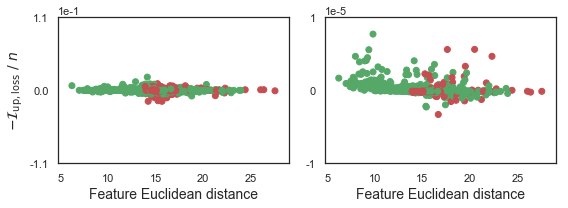

Top from RBF:
1778 -1.0 307.79224 0.9089956 0.009445571899414062
1380 -1.0 363.99655 0.78350437 0.009778806686401367
375 1.0 367.8633 -0.02880904 0.01006583309173584
1741 -1.0 313.85413 0.21034837 0.01301561164855957
1492 -1.0 301.6641 0.33961025 0.019987884521484374


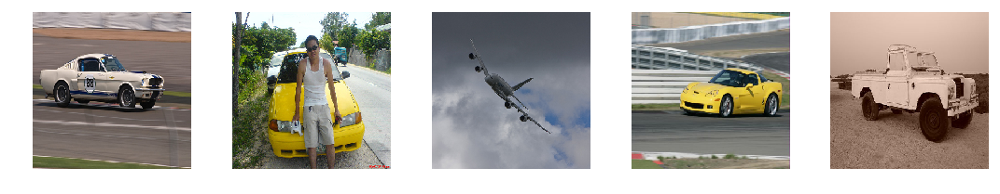

Top from Inception:
871 -1.0 381.16653 5.568379536271096e-06
1681 1.0 341.62878 5.60081796720624e-06
1167 1.0 451.49384 5.615529604256153e-06
39 -1.0 462.58478 7.712246850132942e-06
1321 -1.0 387.46588 1.400597207248211e-05


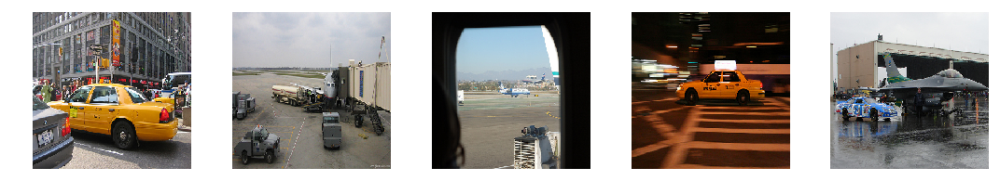

The test index now is 103. 
Test image:
1.0 2.9641123 0.9999639987945557


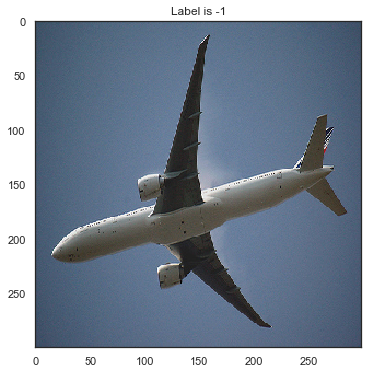

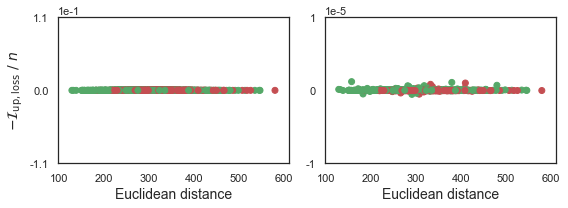

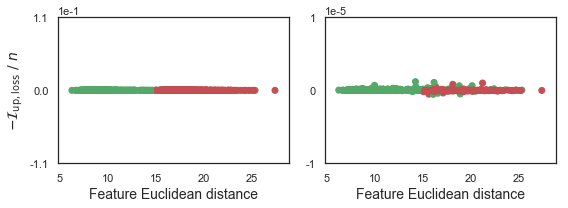

Top from RBF:
659 1.0 286.4309 0.95318365 0.0
658 1.0 247.32217 2.2150776 0.0
657 -1.0 254.54178 2.9128137 0.0
670 -1.0 360.43872 0.9999999 0.0
1999 -1.0 298.2528 0.661788 0.0


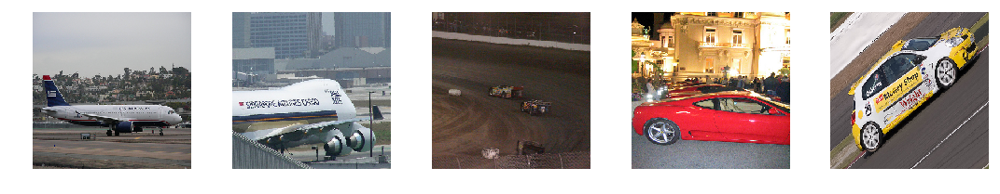

Top from Inception:
1824 1.0 480.30884 6.956649594940246e-07
172 -1.0 332.43747 8.263557683676481e-07
557 -1.0 410.03598 1.0042102076113224e-06
1853 1.0 379.8498 1.0878401808440686e-06
1992 1.0 156.62634 1.194500713609159e-06


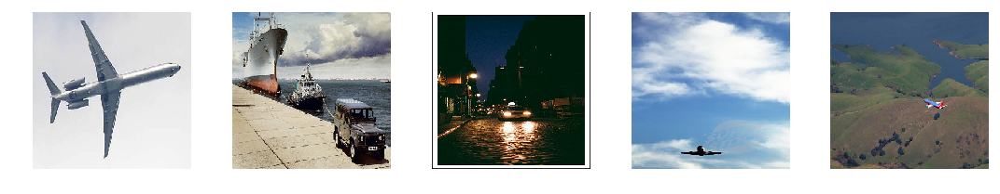

The test index now is 111. 
Test image:
-1.0 0.6257326 0.9998503923416138


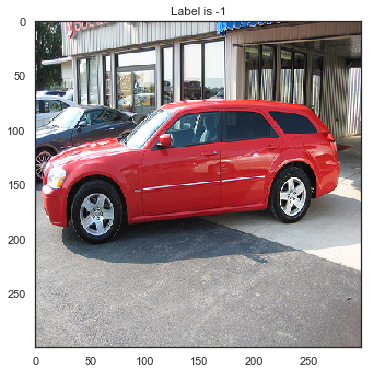

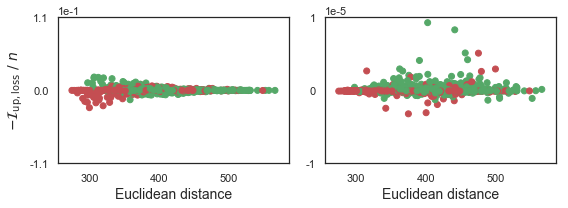

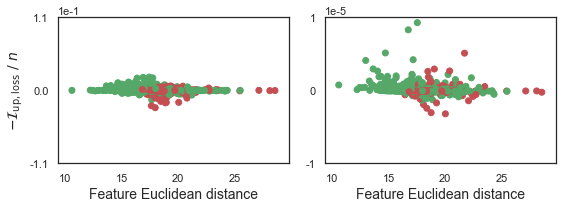

Top from RBF:
904 -1.0 332.5358 0.9889747 0.017642210006713867
1420 -1.0 306.59937 0.5613754 0.018510055541992188
1751 -1.0 320.27155 0.18393847 0.01882051467895508
1864 -1.0 312.8682 0.5211481 0.01959235382080078
406 -1.0 306.86908 0.86590964 0.02007620620727539


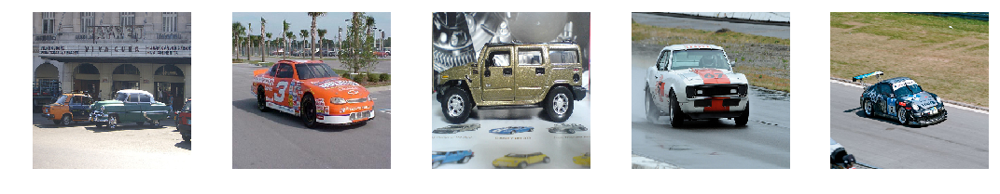

Top from Inception:
1375 -1.0 459.54678 4.200807306915522e-06
1167 1.0 475.0724 5.097553133964539e-06
1907 -1.0 456.1779 5.126206204295158e-06
887 -1.0 441.1694 8.296523243188859e-06
1279 -1.0 402.37823 9.278576821088791e-06


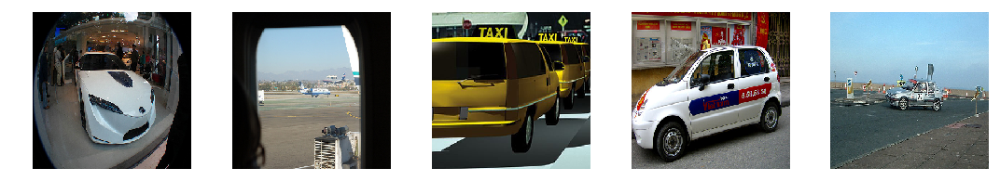

The test index now is 116. 
Test image:
-1.0 0.27412716 0.9999656677246094


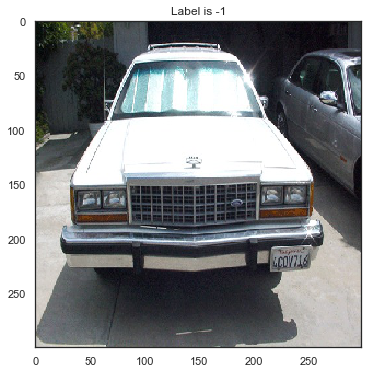

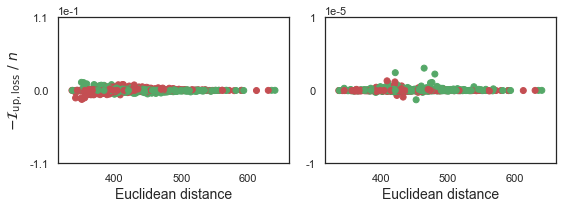

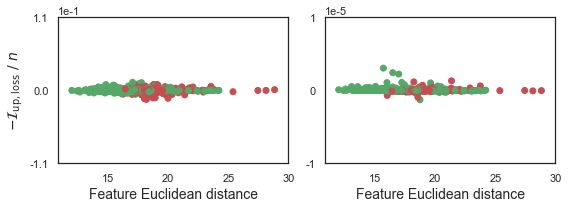

Top from RBF:
367 -1.0 369.66193 0.70514697 0.008753404617309571
127 1.0 413.1966 0.7476586 0.008790413856506347
46 -1.0 358.67554 0.4042192 0.009767654418945313
214 -1.0 354.0429 0.9460112 0.011656545639038085
1928 -1.0 350.76514 0.870455 0.012092720985412598


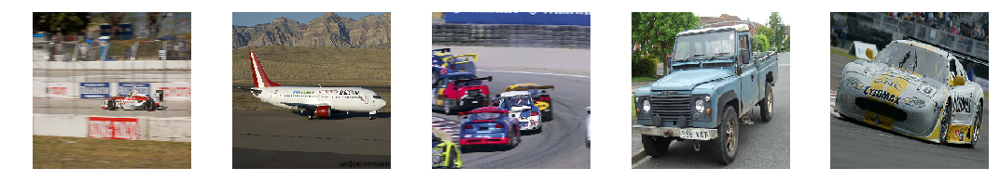

Top from Inception:
1444 1.0 420.45325 1.1592337395995856e-06
1167 1.0 408.6895 1.3051764108240603e-06
1321 -1.0 480.10608 2.233132254332304e-06
887 -1.0 420.96948 2.422692719846964e-06
1375 -1.0 464.07513 3.0444790609180928e-06


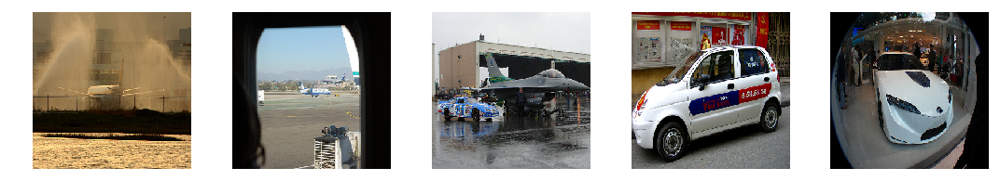

The test index now is 123. 
Test image:
-1.0 0.3931172 0.9988996982574463


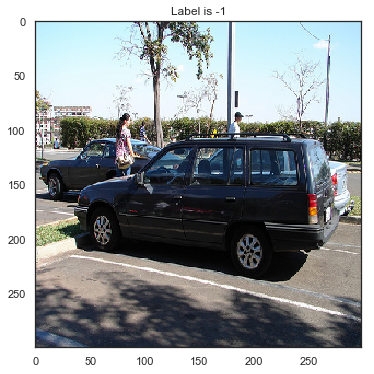

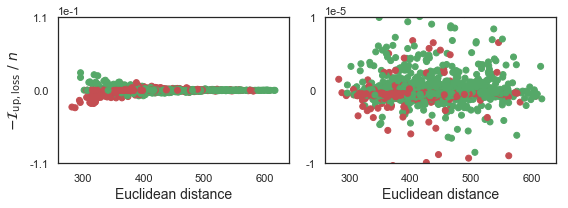

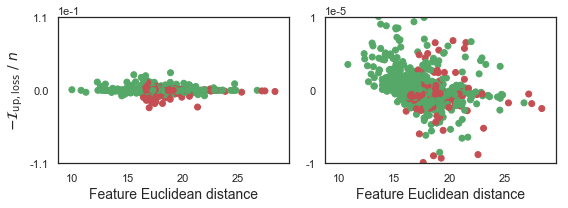

Top from RBF:
1906 -1.0 336.66467 0.7886127 0.015295061111450195
1798 -1.0 295.6122 0.9421646 0.019440500259399415
1292 -1.0 324.16284 0.8922379 0.02205353927612305
1502 -1.0 318.04797 0.683171 0.023588882446289063
1528 -1.0 295.67703 -0.11371253 0.026587909698486328


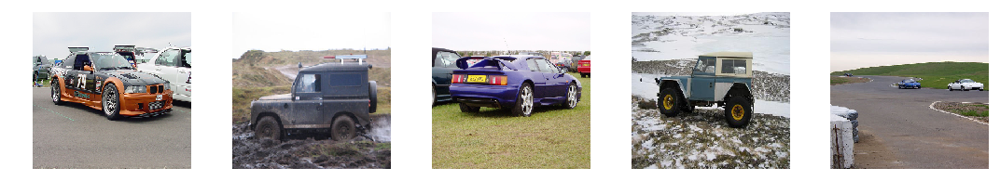

Top from Inception:
382 -1.0 400.63913 2.8749696910381318e-05
1554 -1.0 455.77322 2.905261144042015e-05
1519 -1.0 483.33502 3.133928775787353e-05
1681 1.0 306.52466 5.8653995394706726e-05
887 -1.0 504.91183 0.0001283072531223297


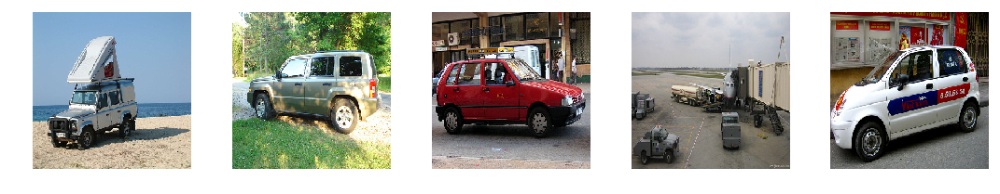

The test index now is 143. 
Test image:
-1.0 -0.5197926 0.9982262253761292


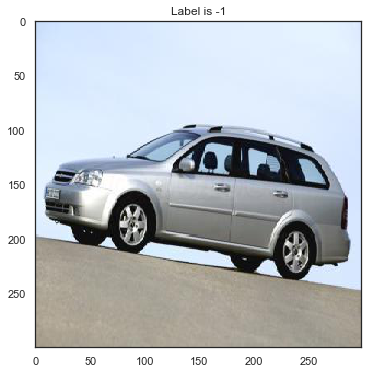

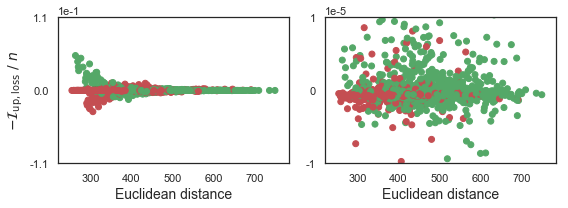

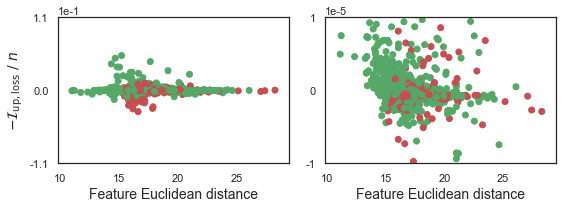

Top from RBF:
37 -1.0 270.3908 -0.91365504 0.035292343139648436
1198 -1.0 297.84518 0.83502525 0.039848037719726566
1528 -1.0 268.92917 -0.11371253 0.043369514465332035
1675 -1.0 276.66037 -0.2574847 0.04844916534423828
933 -1.0 263.47842 -0.30095813 0.052499710083007814


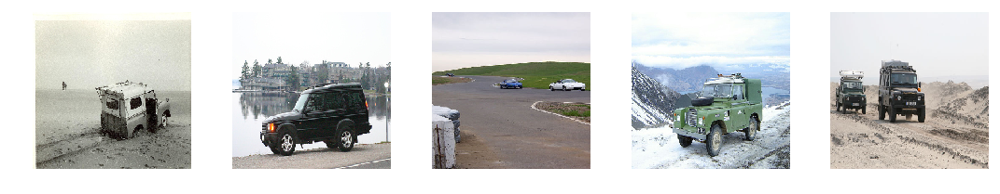

Top from Inception:
1907 -1.0 616.8781 4.818091168999672e-05
1681 1.0 298.87857 5.5170327425003054e-05
382 -1.0 323.01993 5.689529329538345e-05
1375 -1.0 606.4051 7.704129815101624e-05
887 -1.0 534.48785 0.00019585032761096954


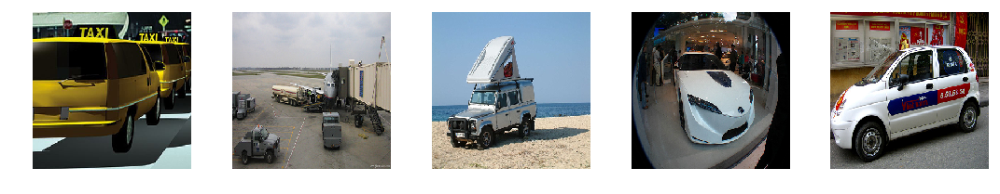

The test index now is 147. 
Test image:
1.0 -1.5385085 0.9997649788856506


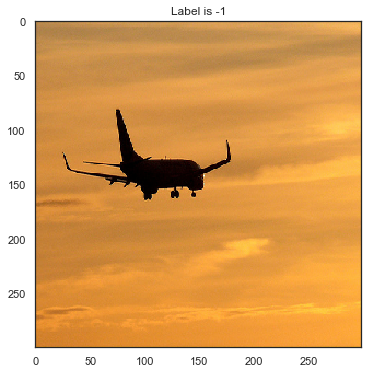

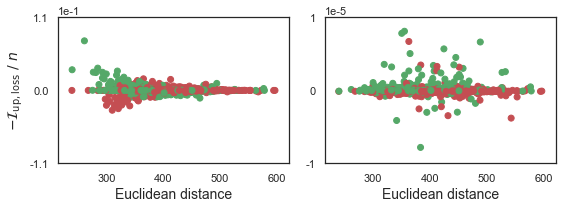

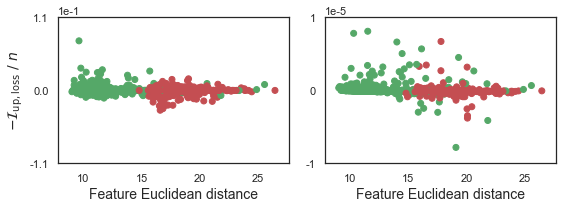

Top from RBF:
1734 1.0 277.06244 0.890124 0.027414661407470703
1444 1.0 319.45596 -1.6013001 0.02910372543334961
1476 1.0 239.74799 -0.23148245 0.031073848724365236
1608 1.0 284.81332 0.07763389 0.033500629425048827
6 1.0 261.37994 -0.746099 0.07466177368164062


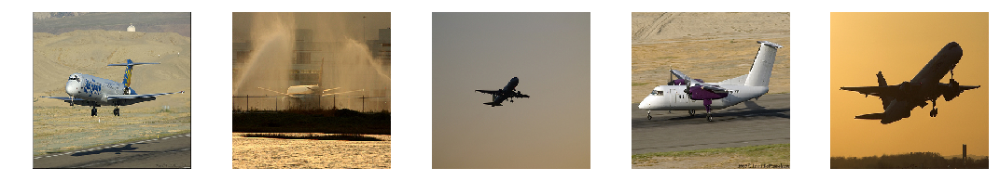

Top from Inception:
172 -1.0 362.84448 6.701664067804813e-06
567 1.0 350.3763 7.817034609615803e-06
1654 1.0 355.12595 8.101286366581917e-06
1167 1.0 482.30096 1.0414063930511474e-05
1853 1.0 426.22147 2.3956280201673508e-05


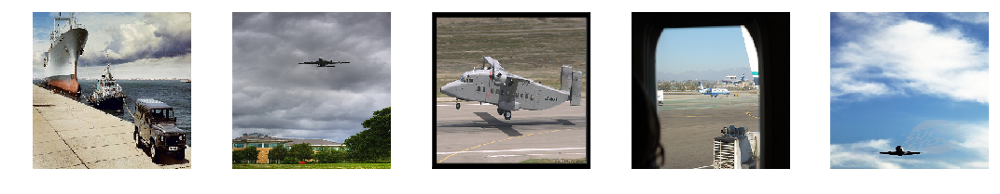

The test index now is 165. 
Test image:
-1.0 0.58662033 0.9976230263710022


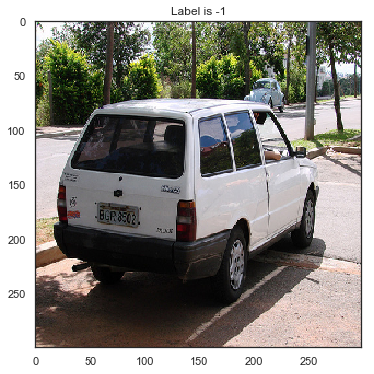

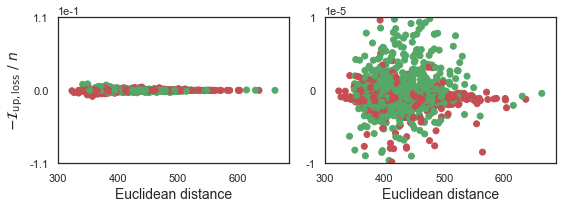

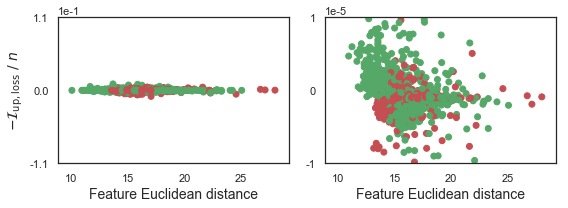

Top from RBF:
1644 -1.0 368.31836 0.68649185 0.006051701068878174
46 -1.0 350.49722 0.4042192 0.007720250129699707
1380 -1.0 380.8748 0.78350437 0.008007680892944336
443 -1.0 341.63635 0.32601932 0.009077828407287597
1146 -1.0 349.7891 0.8016982 0.009707619667053222


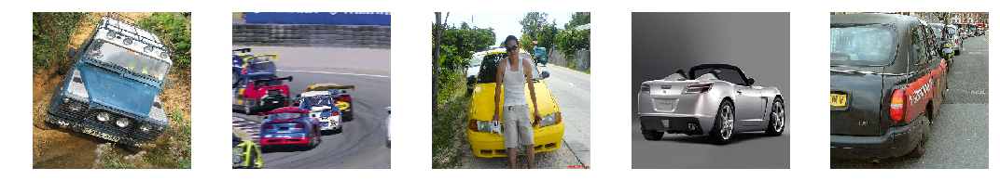

Top from Inception:
481 1.0 427.82288 7.336335629224778e-05
1321 -1.0 462.32626 7.63404220342636e-05
591 -1.0 445.64786 8.16800519824028e-05
1375 -1.0 454.4445 9.431955218315124e-05
887 -1.0 426.06412 0.00027405214309692385


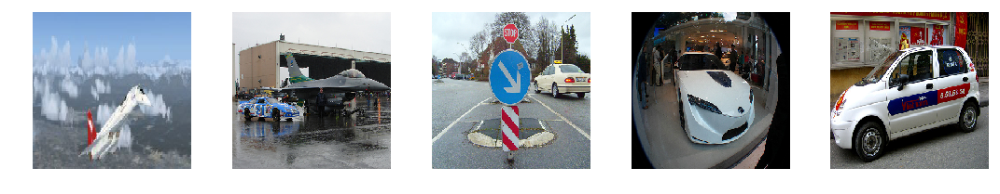

The test index now is 167. 
Test image:
1.0 2.6173942 0.9998279809951782


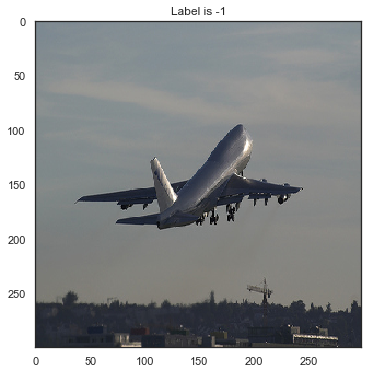

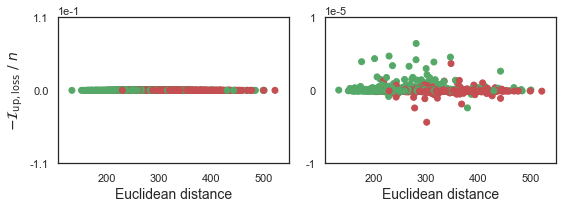

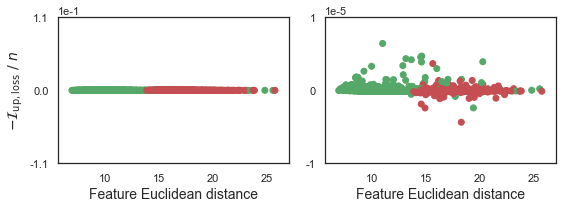

Top from RBF:
659 1.0 233.23271 0.95318365 0.0
658 1.0 254.74557 2.2150776 0.0
657 -1.0 307.226 2.9128137 0.0
670 -1.0 325.0767 0.9999999 0.0
1999 -1.0 287.5601 0.661788 0.0


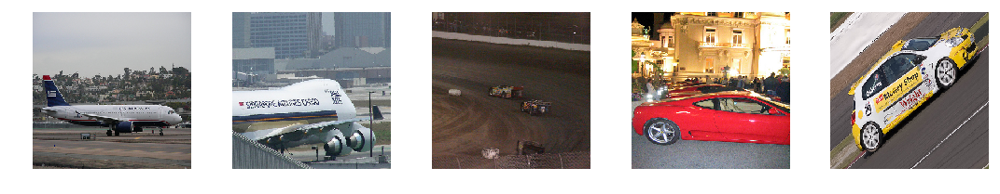

Top from Inception:
1632 1.0 280.91647 4.19553555548191e-06
1992 1.0 201.47934 4.347395151853561e-06
1853 1.0 346.79523 4.558220505714416e-06
1681 1.0 229.25204 4.699527285993099e-06
1116 1.0 281.0982 6.425658706575632e-06


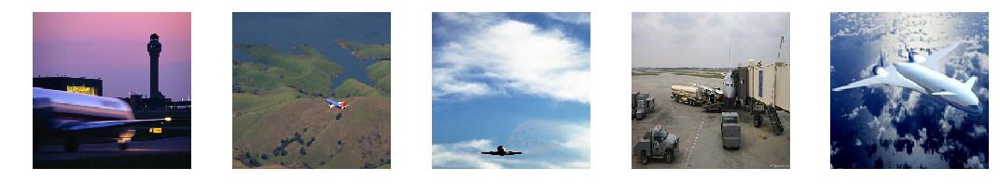

The test index now is 168. 
Test image:
-1.0 -1.0821979 0.9956640601158142


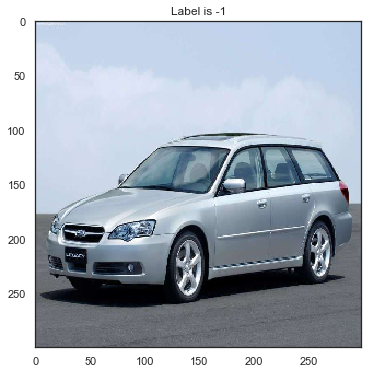

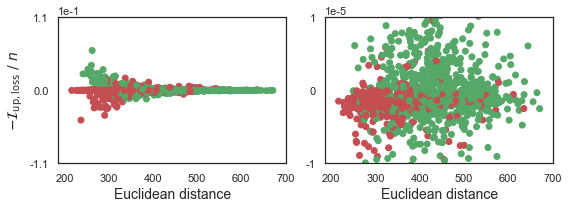

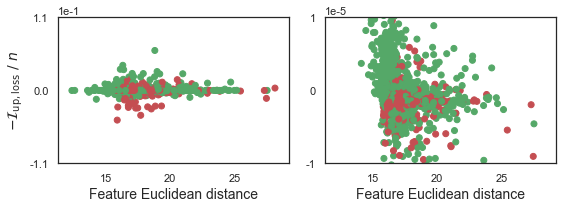

Top from RBF:
1528 -1.0 260.84674 -0.11371253 0.028366336822509764
382 -1.0 287.28683 -0.36394346 0.031208663940429687
37 -1.0 252.91756 -0.91365504 0.031776453018188475
188 -1.0 260.73132 -2.6593988 0.037766613006591794
28 -1.0 262.55832 -3.2414358 0.06013816070556641


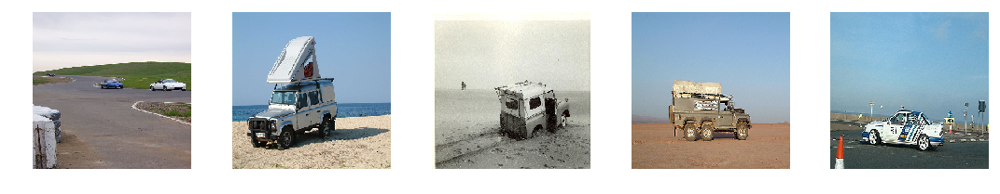

Top from Inception:
1554 -1.0 428.215 9.144719690084457e-05
1681 1.0 260.81424 9.223967790603638e-05
1907 -1.0 562.3246 9.303884953260422e-05
1279 -1.0 241.86998 9.796290099620819e-05
887 -1.0 478.2222 0.0004962528645992279


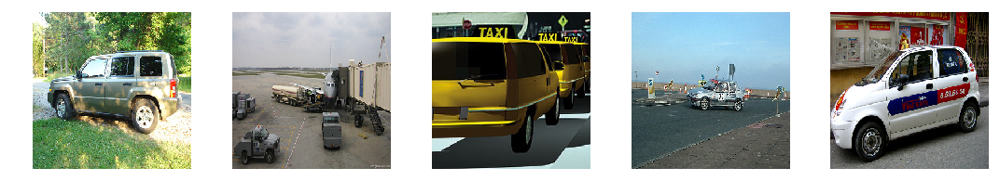

The test index now is 176. 
Test image:
1.0 0.4057076 0.9999661445617676


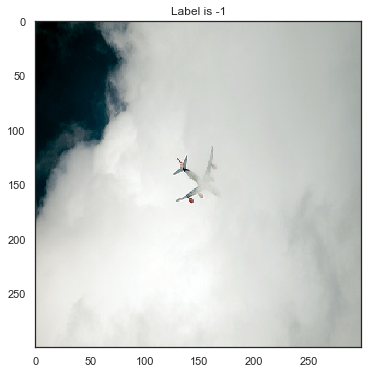

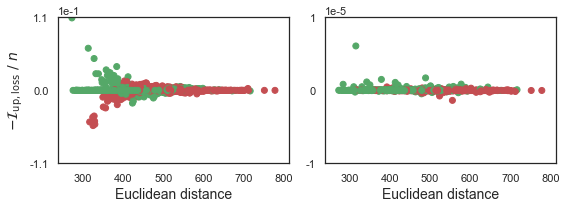

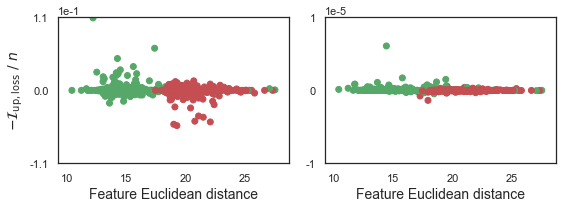

Top from RBF:
1987 1.0 357.39154 0.4670807 0.03091682815551758
1760 1.0 383.71198 0.7475885 0.03587273025512695
433 1.0 327.26608 0.11117394 0.0479983024597168
790 1.0 312.6701 0.83272135 0.06350328826904297
1923 1.0 271.95364 0.57995605 0.1092040557861328


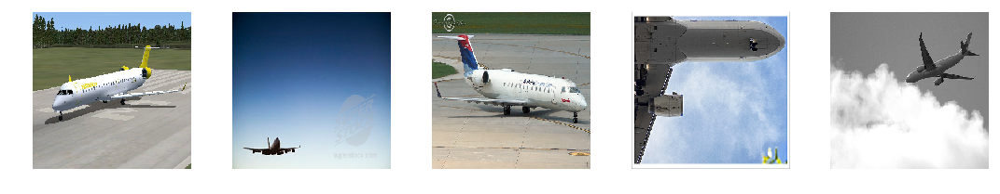

Top from Inception:
567 1.0 412.9053 1.0922832880169153e-06
902 1.0 341.74686 1.1526553425937891e-06
481 1.0 378.32065 1.500008162111044e-06
1992 1.0 488.56357 1.7070388421416284e-06
1853 1.0 314.5946 6.084976717829705e-06


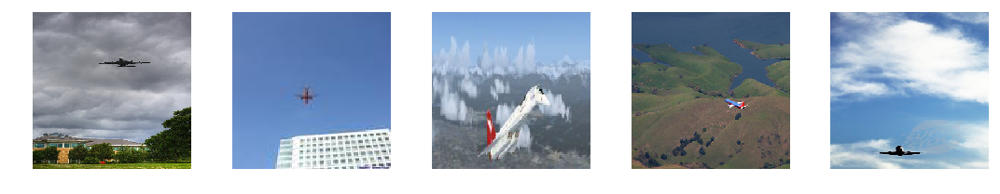

The test index now is 179. 
Test image:
1.0 3.4468806 0.9999605417251587


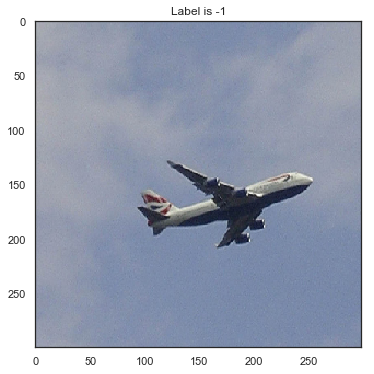

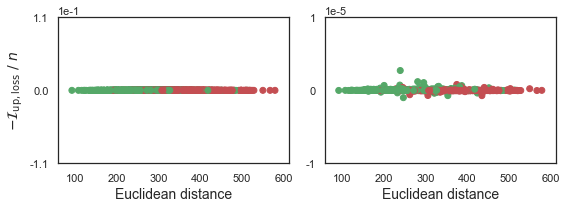

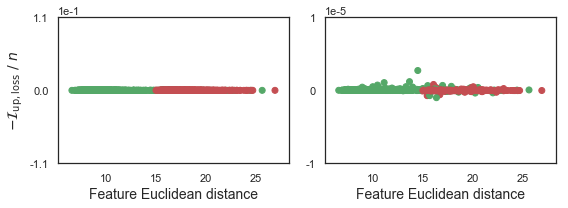

Top from RBF:
659 1.0 263.62064 0.95318365 0.0
658 1.0 243.63432 2.2150776 0.0
657 -1.0 392.8412 2.9128137 0.0
670 -1.0 337.6123 0.9999999 0.0
1999 -1.0 310.19345 0.661788 0.0


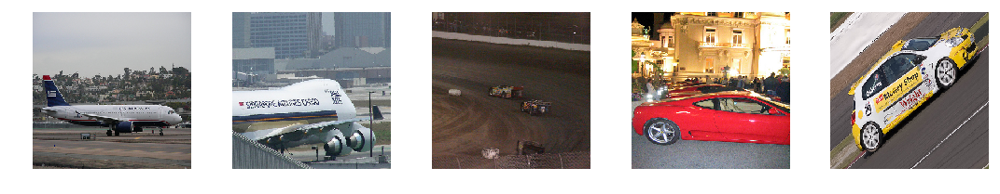

Top from Inception:
567 1.0 238.43614 7.242565043270588e-07
887 -1.0 375.1147 8.06783908046782e-07
1654 1.0 295.82294 1.0622594272717833e-06
1992 1.0 281.36053 1.1945561273023486e-06
1853 1.0 239.50232 2.7179447934031487e-06


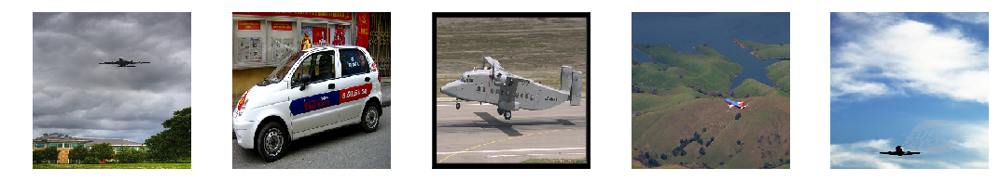

The test index now is 205. 
Test image:
1.0 2.66645 0.9993952512741089


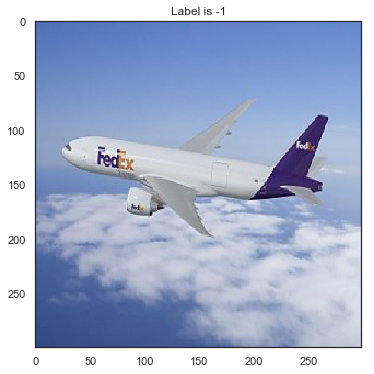

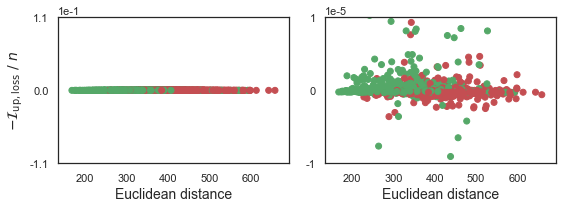

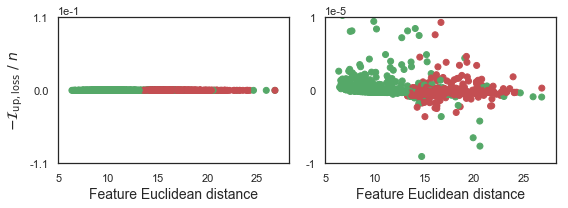

Top from RBF:
659 1.0 337.9396 0.95318365 0.0
658 1.0 281.105 2.2150776 0.0
657 -1.0 489.65457 2.9128137 0.0
670 -1.0 407.05762 0.9999999 0.0
1999 -1.0 385.01254 0.661788 0.0


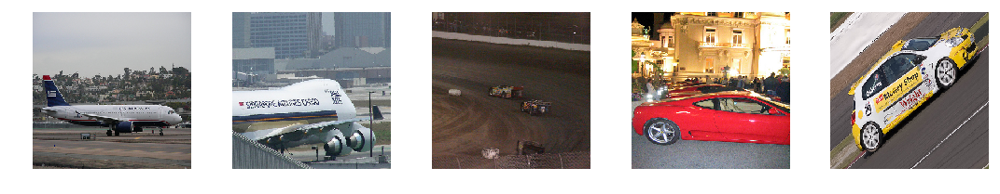

Top from Inception:
167 1.0 375.34467 1.8588904291391374e-05
1824 1.0 319.34686 1.9412346184253694e-05
1116 1.0 392.17737 2.0942021161317826e-05
1853 1.0 240.17639 2.708514966070652e-05
481 1.0 234.58015 3.221330046653747e-05


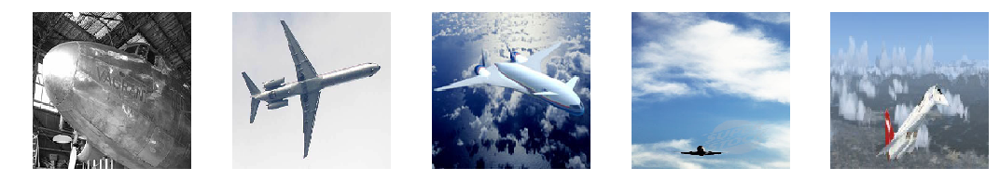

The test index now is 243. 
Test image:
1.0 -0.010501001 0.9998599290847778


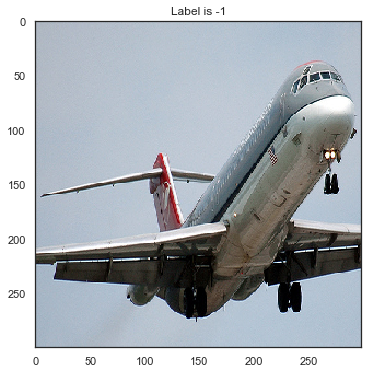

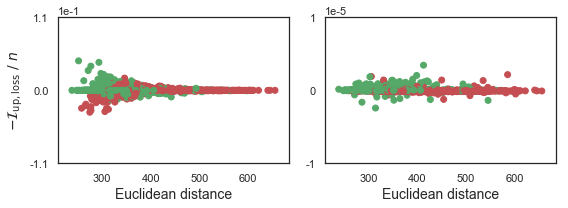

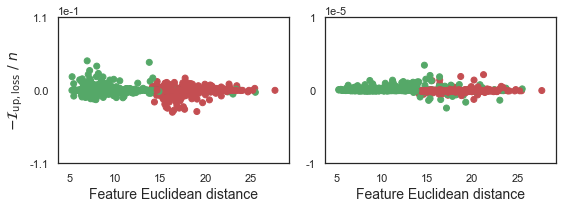

Top from RBF:
753 1.0 298.0726 0.8057581 0.025516189575195313
940 1.0 271.80878 0.90571034 0.02989768600463867
1183 1.0 277.36282 0.9003395 0.03653411865234375
1203 1.0 293.86887 0.7311891 0.04223456573486328
849 1.0 252.13095 0.85897005 0.044487087249755856


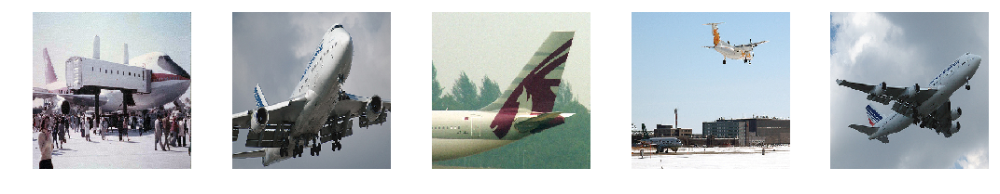

Top from Inception:
1681 1.0 302.47116 1.8605447839945555e-06
1279 -1.0 305.4245 1.9015007419511676e-06
1632 1.0 398.54065 2.0429368596524e-06
557 -1.0 585.30676 2.1548434160649776e-06
167 1.0 412.58414 3.4501771442592142e-06


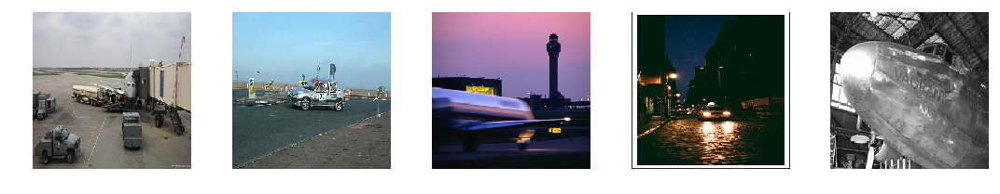

The test index now is 268. 
Test image:
-1.0 0.25620753 0.9983772039413452


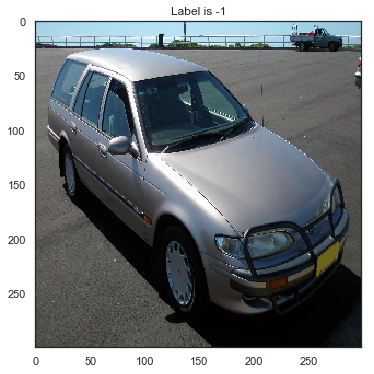

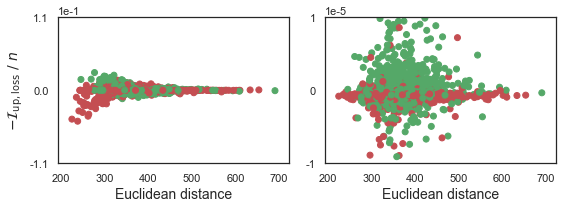

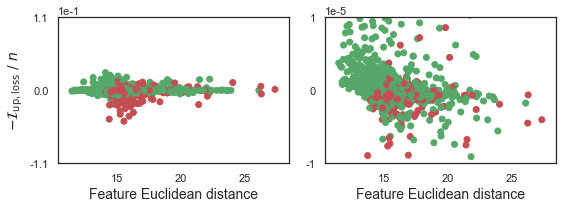

Top from RBF:
1182 -1.0 316.00482 0.8218254 0.019733388900756835
943 -1.0 302.15704 -0.4279235 0.02089080047607422
1493 -1.0 299.23322 0.44275093 0.021586002349853514
174 -1.0 321.55478 0.5045836 0.022852260589599608
1945 -1.0 276.96335 0.5371687 0.026832210540771485


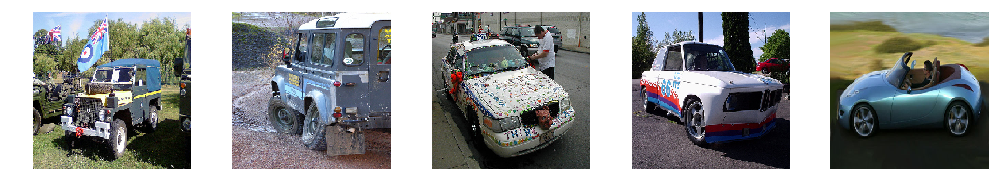

Top from Inception:
1167 1.0 423.14334 3.113698959350586e-05
500 1.0 345.54227 4.4104762375354764e-05
887 -1.0 410.35535 7.318612188100815e-05
1321 -1.0 367.86197 7.55486786365509e-05
1375 -1.0 353.7991 9.397386014461518e-05


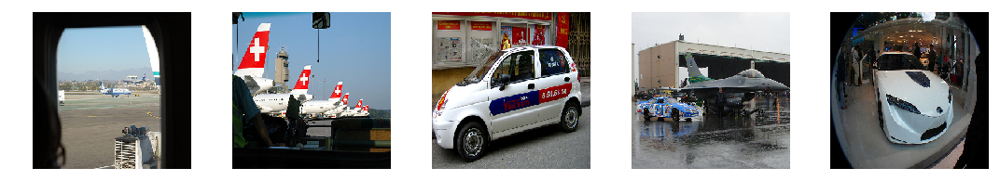

The test index now is 280. 
Test image:
-1.0 0.22862454 0.9977400302886963


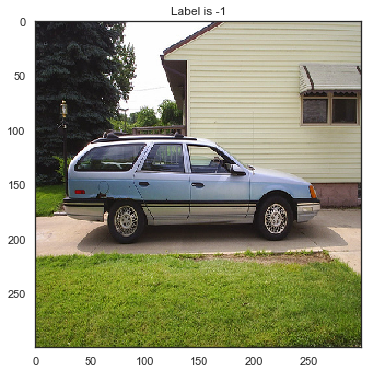

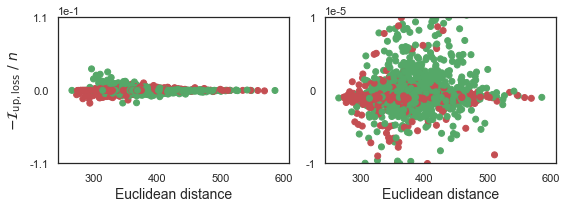

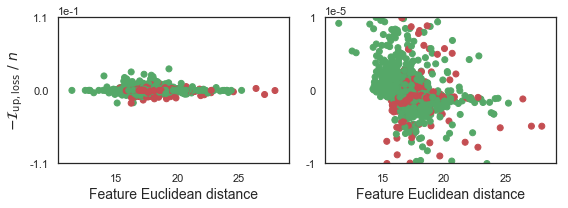

Top from RBF:
1451 -1.0 304.3672 0.7707778 0.021726966857910156
1536 -1.0 304.06705 -0.16561052 0.022839345932006837
970 -1.0 310.30212 0.7084322 0.024281532287597656
1657 -1.0 322.1271 0.8342478 0.02776675796508789
1644 -1.0 296.67993 0.68649185 0.032387935638427734


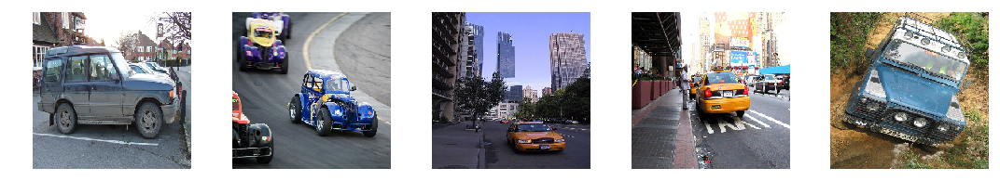

Top from Inception:
557 -1.0 498.68454 6.927882879972458e-05
1321 -1.0 385.01306 7.154518365859985e-05
382 -1.0 381.3726 8.254329860210418e-05
1279 -1.0 343.39975 0.0001168845295906067
887 -1.0 420.3129 0.0002768159508705139


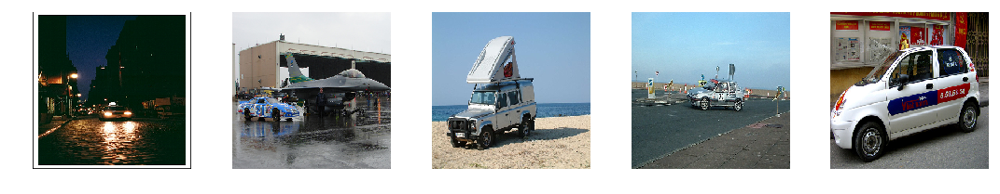

The test index now is 324. 
Test image:
-1.0 0.31370392 0.996356725692749


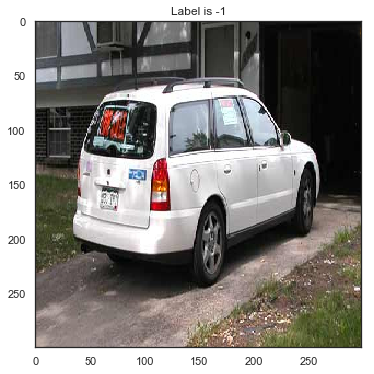

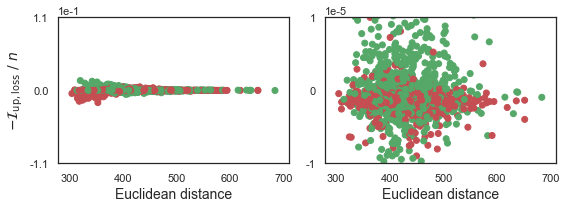

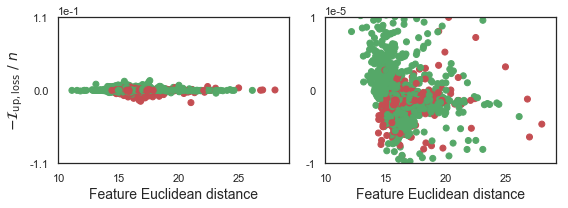

Top from RBF:
1213 -1.0 373.64316 0.7508333 0.009427130699157715
717 -1.0 329.03357 0.34833285 0.010833598136901856
1865 -1.0 351.9234 0.8252682 0.012628717422485352
1202 -1.0 342.61972 0.7686996 0.013727476119995117
401 -1.0 320.55435 -0.6263331 0.014753787994384766


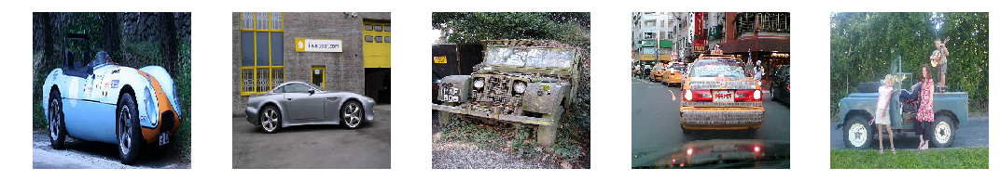

Top from Inception:
1519 -1.0 390.57642 7.25274458527565e-05
591 -1.0 437.18713 8.618403226137161e-05
1907 -1.0 436.40088 0.00010554751753807068
1375 -1.0 375.48138 0.00014412763714790345
887 -1.0 381.5531 0.0003619565963745117


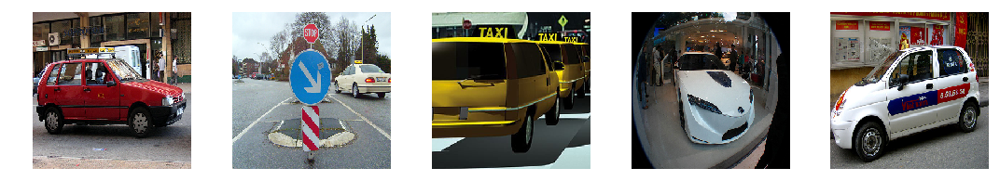

The test index now is 359. 
Test image:
-1.0 0.6150051 0.9985613226890564


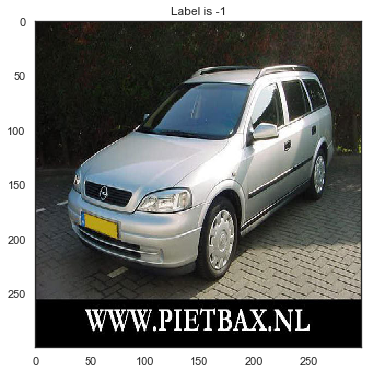

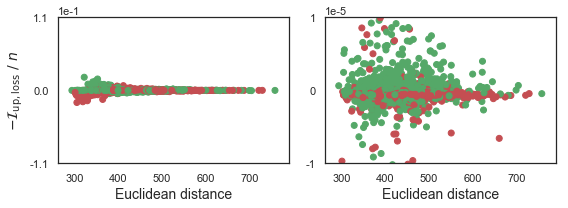

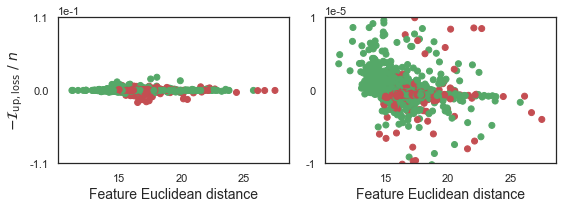

Top from RBF:
527 -1.0 359.32703 0.8675945 0.009413703918457032
1701 -1.0 341.66248 0.8331068 0.01277608585357666
1720 -1.0 348.65622 0.88240933 0.014501928329467773
1602 -1.0 352.75922 0.95454156 0.01713629913330078
536 -1.0 322.20187 0.054952785 0.01978708267211914


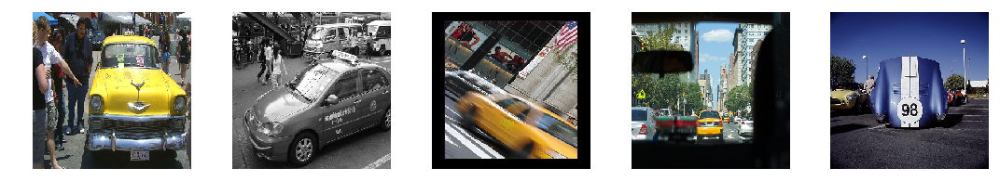

Top from Inception:
1519 -1.0 420.04257 2.5977710261940956e-05
500 1.0 424.51477 3.266844898462296e-05
1907 -1.0 428.78702 3.32939475774765e-05
1375 -1.0 330.59732 6.109379976987838e-05
887 -1.0 409.014 0.00016887351870536804


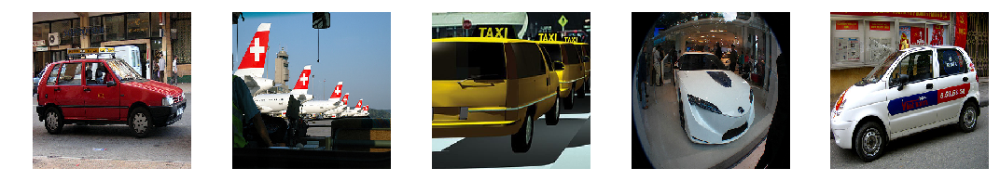

The test index now is 365. 
Test image:
-1.0 0.27810648 0.9980308413505554


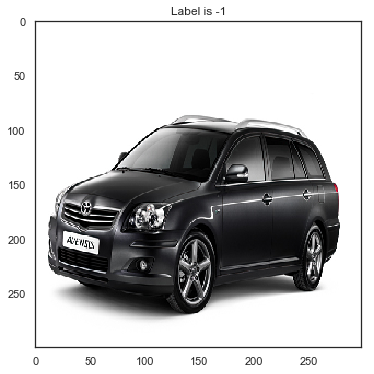

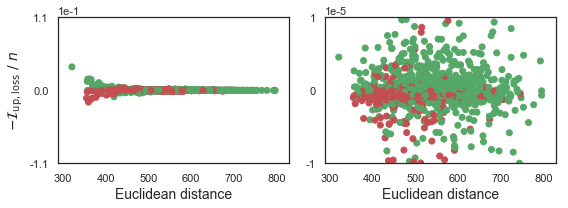

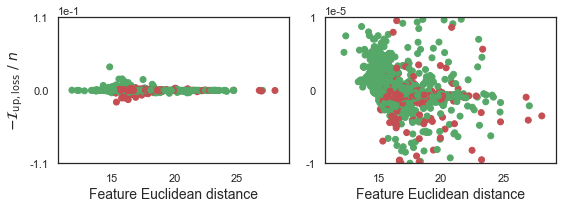

Top from RBF:
933 -1.0 357.09286 -0.30095813 0.01352449607849121
1488 -1.0 366.10553 0.52524865 0.016297401428222655
1675 -1.0 358.26984 -0.2574847 0.017029220581054688
1664 -1.0 362.748 -0.04828909 0.017248783111572265
1198 -1.0 321.23093 0.83502525 0.03536774444580078


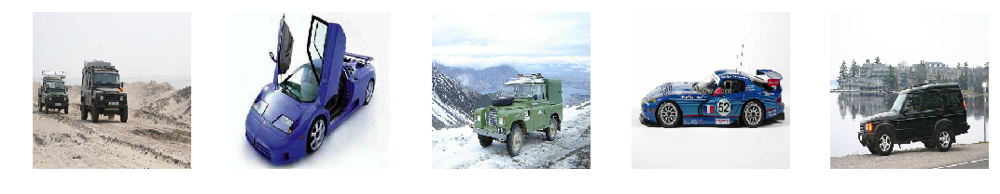

Top from Inception:
1554 -1.0 515.0753 3.8102835416793823e-05
1000 -1.0 543.61743 3.822744265198708e-05
1375 -1.0 708.28955 4.843376949429512e-05
1907 -1.0 651.58575 5.783624202013016e-05
887 -1.0 598.78723 0.0001941908448934555


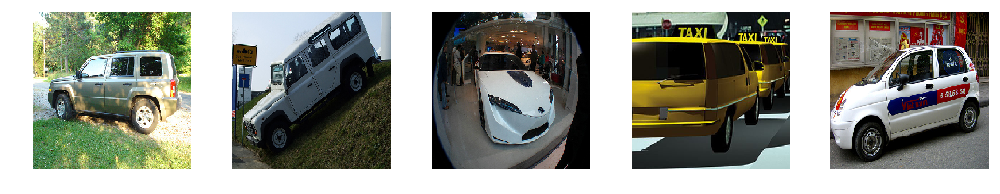

The test index now is 406. 
Test image:
-1.0 0.83681136 0.9995705485343933


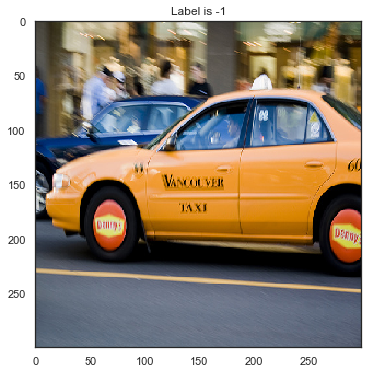

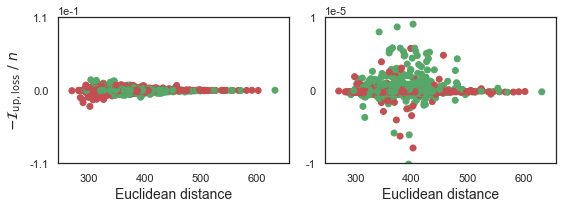

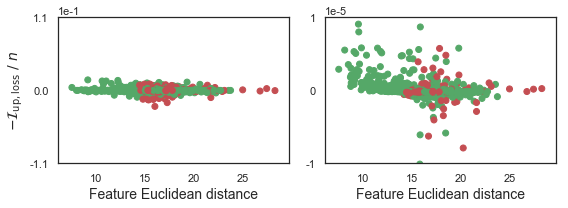

Top from RBF:
690 -1.0 310.01224 0.8879044 0.012439627647399903
527 -1.0 344.92645 0.8675945 0.014119709968566894
874 -1.0 345.38947 0.6738922 0.014150647163391114
1741 -1.0 313.7536 0.21034837 0.014987058639526367
80 -1.0 303.71002 -0.20259646 0.015799436569213867


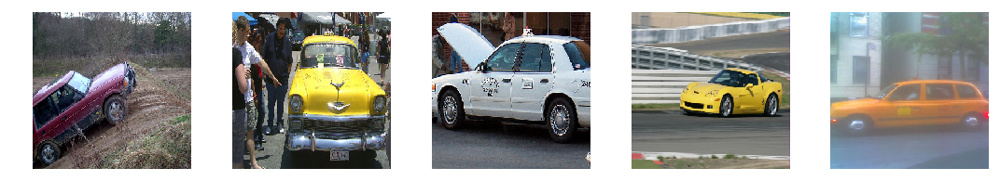

Top from Inception:
1866 -1.0 316.5167 1.1208572424948215e-05
1072 -1.0 343.54886 1.2850463390350342e-05
871 -1.0 345.1471 1.3382868841290473e-05
39 -1.0 417.95184 1.5313426963984967e-05
1321 -1.0 403.73502 2.0405426621437073e-05


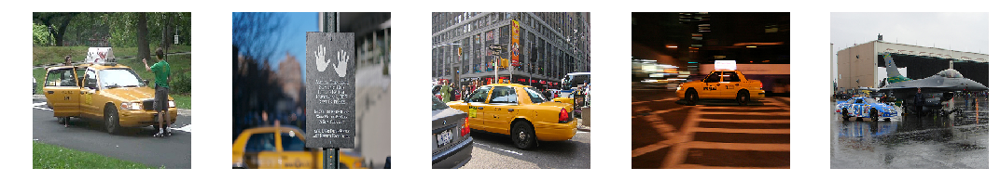

The test index now is 522. 
Test image:
-1.0 0.33905092 0.9999617338180542


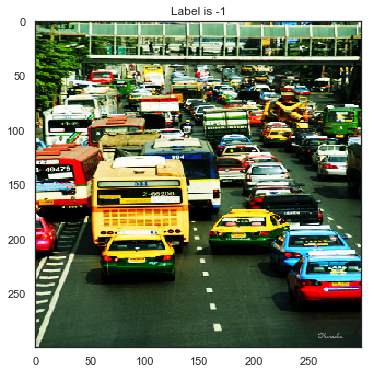

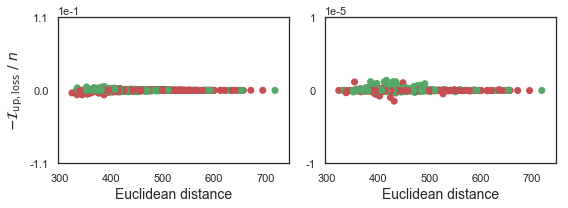

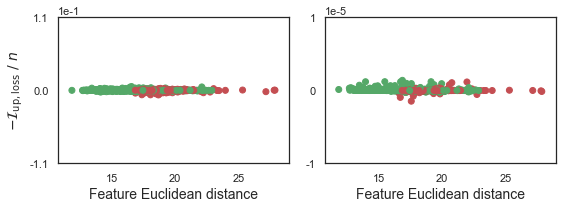

Top from RBF:
972 -1.0 383.95798 0.22358465 0.003825836181640625
407 -1.0 367.0346 0.94769424 0.003959677219390869
240 -1.0 381.2723 0.5792671 0.0048900098800659176
1961 -1.0 352.34833 0.90489644 0.005149169445037842
1552 -1.0 387.154 0.64621115 0.005732025146484375


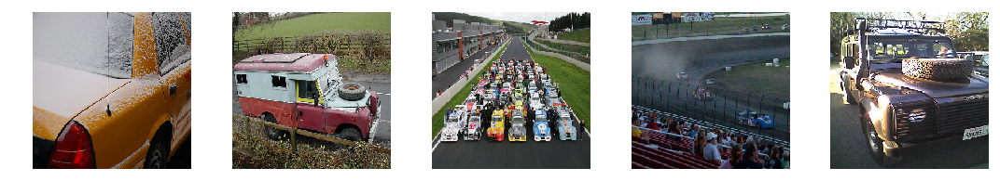

Top from Inception:
1375 -1.0 412.0239 1.1702582705765962e-06
1645 -1.0 429.14786 1.181031228043139e-06
1171 -1.0 385.69745 1.1874665506184101e-06
1602 -1.0 434.74243 1.188762951642275e-06
70 -1.0 416.47787 1.3729387428611517e-06


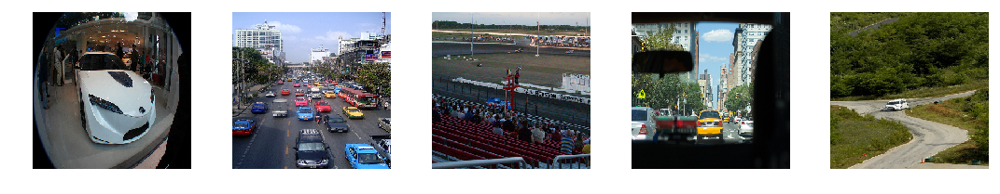

The test index now is 533. 
Test image:
1.0 1.0215217 0.9999713897705078


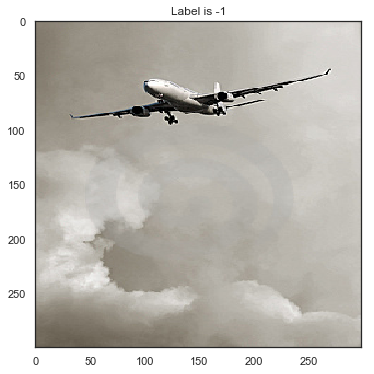

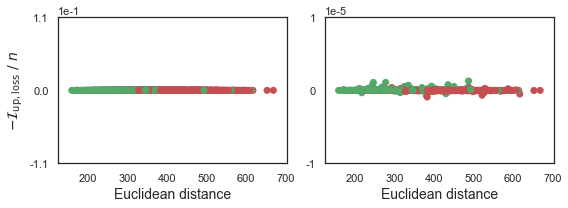

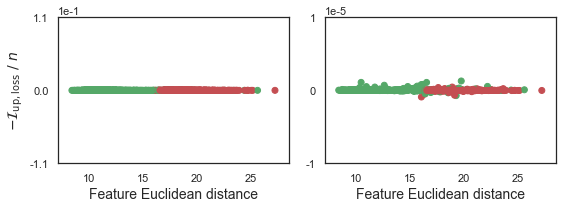

Top from RBF:
1797 1.0 253.99759 0.8507645 2.0713142312445143e-13
1230 1.0 503.79193 -2.0890977 2.1296217567190467e-13
1203 1.0 293.82883 0.7311891 2.1623795809500023e-13
1095 1.0 251.66927 0.7069117 2.7972002492049343e-13
737 1.0 205.7501 0.64569443 3.5319974722725076e-13


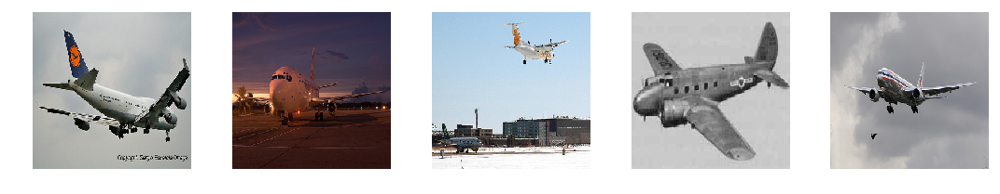

Top from Inception:
500 1.0 436.08896 7.786507485434413e-07
1012 1.0 245.51591 8.131096255965531e-07
1853 1.0 247.07338 1.0872671846300364e-06
567 1.0 278.14105 1.0916553437709808e-06
1167 1.0 488.1162 1.2842048890888692e-06


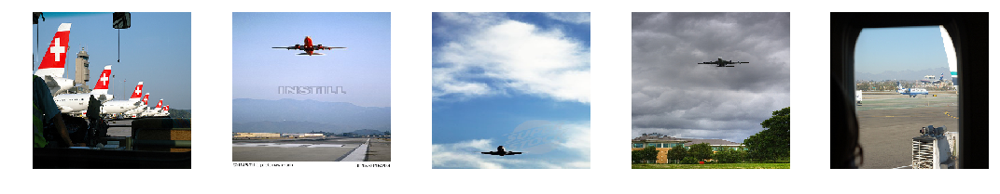

The test index now is 549. 
Test image:
-1.0 0.045294426 0.9960487484931946


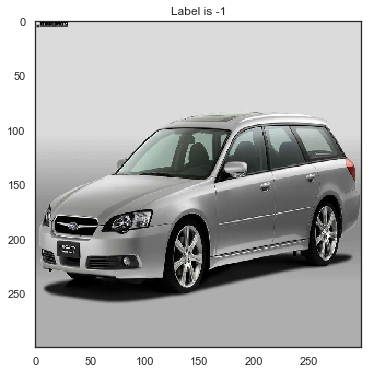

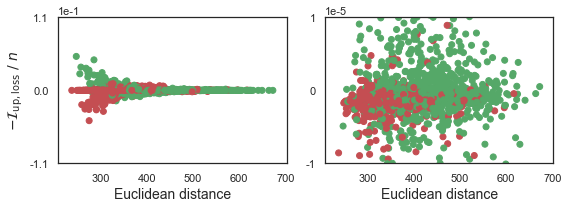

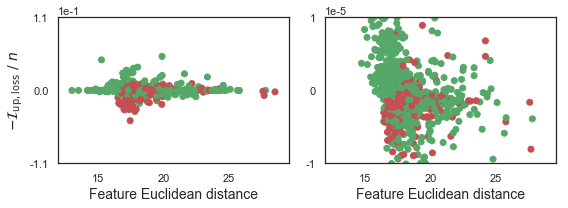

Top from RBF:
1798 -1.0 269.33823 0.9421646 0.031557594299316406
533 -1.0 268.19098 0.33473837 0.03336325073242188
1579 -1.0 256.97836 -0.49234468 0.03506327819824219
1198 -1.0 285.2889 0.83502525 0.04600318145751953
1528 -1.0 246.9695 -0.11371253 0.05118869400024414


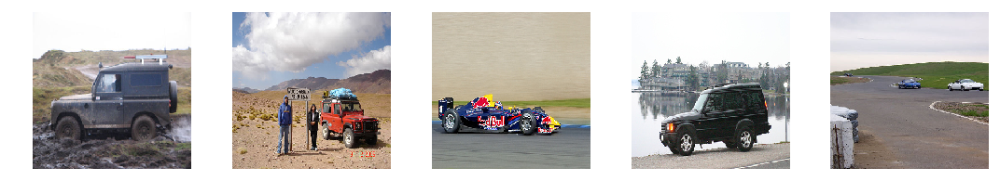

Top from Inception:
172 -1.0 353.90506 8.898887783288956e-05
500 1.0 440.36026 8.906394243240356e-05
1554 -1.0 410.03687 8.95845741033554e-05
1375 -1.0 551.1033 9.131675958633422e-05
887 -1.0 469.664 0.0003817793130874634


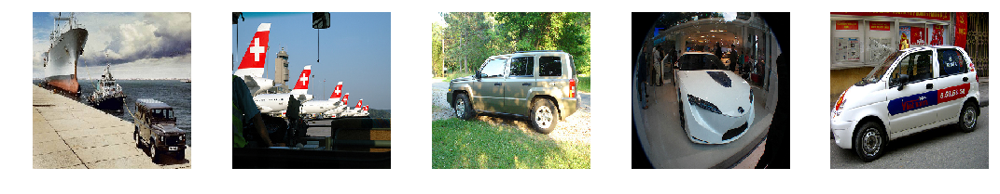

The test index now is 576. 
Test image:
1.0 1.9089643 0.9999417066574097


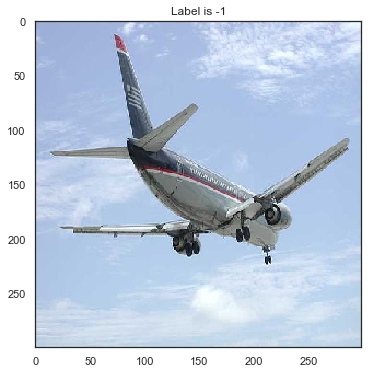

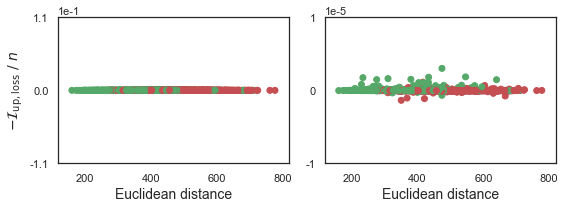

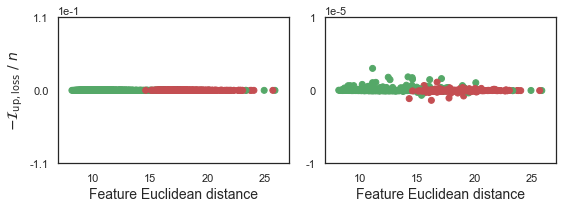

Top from RBF:
659 1.0 403.09354 0.95318365 0.0
658 1.0 381.67633 2.2150776 0.0
657 -1.0 587.8271 2.9128137 0.0
670 -1.0 443.90698 0.9999999 0.0
1999 -1.0 457.15967 0.661788 0.0


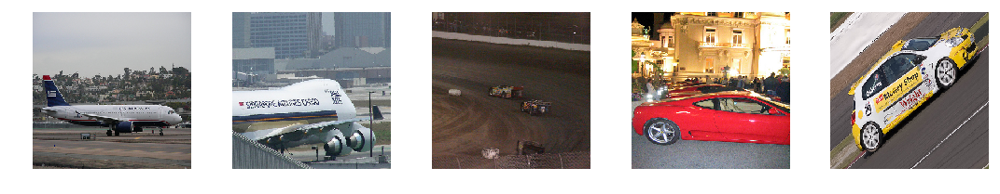

Top from Inception:
481 1.0 310.21115 1.6107914270833136e-06
1853 1.0 234.02983 1.7404304817318915e-06
1707 1.0 433.56897 1.7975301016122102e-06
500 1.0 545.7472 1.8481570295989514e-06
1116 1.0 474.1265 3.0100508593022823e-06


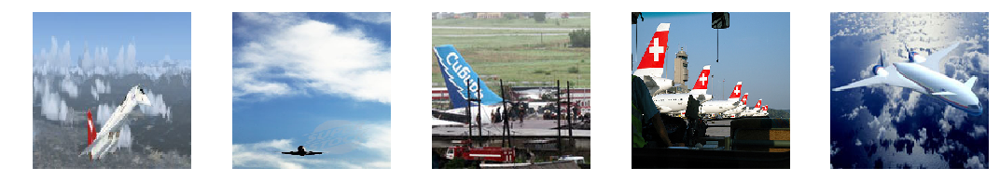

The test index now is 583. 
Test image:
-1.0 1.3925538 0.998539924621582


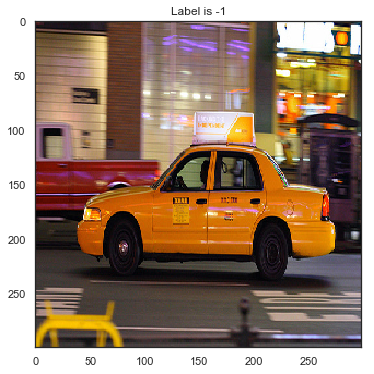

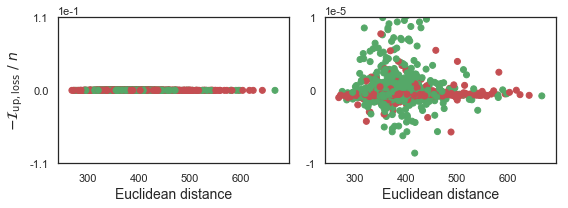

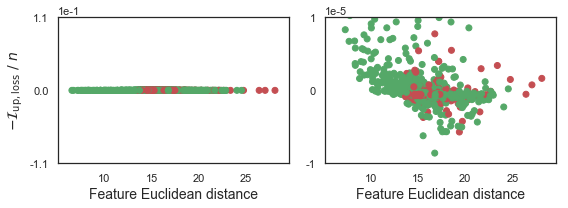

Top from RBF:
659 1.0 332.0 0.95318365 0.0
658 1.0 383.03668 2.2150776 0.0
657 -1.0 317.12036 2.9128137 0.0
670 -1.0 372.07935 0.9999999 0.0
1999 -1.0 366.7752 0.661788 0.0


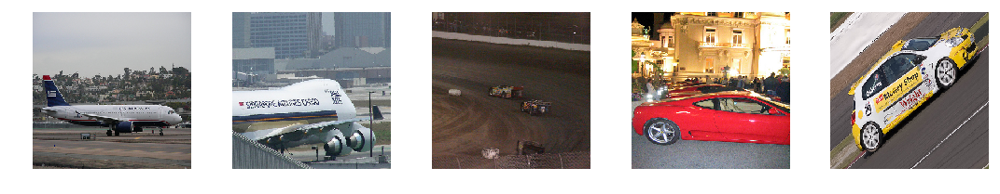

Top from Inception:
662 -1.0 331.92932 4.200732707977295e-05
871 -1.0 341.70978 4.8470623791217805e-05
1995 -1.0 357.0176 5.1950745284557344e-05
887 -1.0 411.74008 5.7066261768341065e-05
39 -1.0 387.3055 7.027976214885712e-05


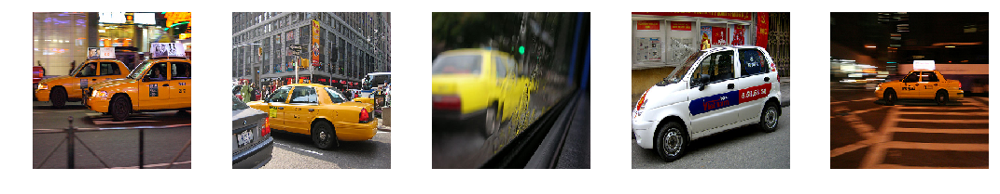

In [30]:
#coding:utf-8
for i in [15, 18, 38, 41, 59, 91, 99, 103, 111, 116, 123, 143, 147, 165, 167, 168, 
          176, 179, 205, 243, 268, 280, 324, 359, 365, 406, 522, 533, 549, 576, 583]:
    f = np.load('output6/rbf_carair_results_%s.npz' % i)

    test_idx = f['test_idx']
    distances = f['distances']
    flipped_idx = f['flipped_idx']
    rbf_margins_test = f['rbf_margins_test']
    rbf_margins_train = f['rbf_margins_train']
    inception_Y_pred_correct = f['inception_Y_pred_correct']
    rbf_predicted_loss_diffs = f['rbf_predicted_loss_diffs']
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']
    
    print('The test index now is %s. ' % i)
    sns.set_style('white')
    fontsize=14    
    
    print('Test image:')
    print(Y_test[test_idx], rbf_margins_test[test_idx], inception_Y_pred_correct[test_idx])
    plot_flat_colorimage((X_test[test_idx, :] + 1) / 2, 0, side=299)
    
    #画欧几里得距离
    fig, axs = plt.subplots(1, 2, sharex=True, sharey=False, figsize=(8, 3))

    num_train = len(flipped_idx)
    color_vec = np.array(['g'] * num_train)
    color_vec[flipped_idx] = 'r'
    color_vec = list(color_vec)

    axs[0].scatter(distances, inception_predicted_loss_diffs, color=color_vec)
    axs[0].set_ylim(-0.000007, 0.000007)
    axs[0].set_yticks((-0.000005, 0, 0.000005))
    axs[0].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[0].set_title("Inception-v3")
    axs[0].set_xlabel('Euclidean distance', fontsize=fontsize)
    axs[0].set_ylabel('$-\mathcal{I}_\mathrm{up, loss} \ /\ n$', fontsize=fontsize)

    axs[1].scatter(distances, rbf_predicted_loss_diffs, color=color_vec)
    axs[1].set_ylim(-0.05, 0.05)
    axs[1].set_yticks((-0.05, 0, 0.05))
    axs[1].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[1].set_title("RBF-SVM")
    axs[1].set_xlabel('Euclidean distance', fontsize=fontsize)

    plt.tight_layout()
    plt.show()
    
    #画特征值距离
    feature_distances = np.zeros((2000))
    for j in range(2000):
        feature_distances[j] = np.linalg.norm(test_features[i]-train_features[j])
    fig, axs = plt.subplots(1, 2, sharex=True, sharey=False, figsize=(8, 3))

    num_train = len(flipped_idx)
    color_vec = np.array(['g'] * num_train)
    color_vec[flipped_idx] = 'r'
    color_vec = list(color_vec)

    axs[0].scatter(feature_distances, inception_predicted_loss_diffs, color=color_vec)
    axs[0].set_ylim(-0.000007, 0.000007)
    axs[0].set_yticks((-0.000007, 0, 0.000007))
    axs[0].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[0].set_title("Inception-v3")
    axs[0].set_xlabel('Feature Euclidean distance', fontsize=fontsize)
    axs[0].set_ylabel('$-\mathcal{I}_\mathrm{up, loss} \ /\ n$', fontsize=fontsize)

    axs[1].scatter(feature_distances, rbf_predicted_loss_diffs, color=color_vec)
    axs[1].set_ylim(-0.05, 0.05)
    axs[1].set_yticks((-0.05, 0, 0.05))
    axs[1].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[1].set_title("RBF-SVM")
    axs[1].set_xlabel('Feature Euclidean distance', fontsize=fontsize)
    
    plt.tight_layout()
    plt.show()
    
    print('Top from RBF:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(rbf_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], rbf_margins_train[train_idx], rbf_predicted_loss_diffs[train_idx])
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.show()

    print('Top from Inception:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.show()

In [22]:
feature_distances = np.zeros((2000))
for i in range(2000):
    feature_distances[i] = np.linalg.norm(test_features[176]-train_features[i])

The test index now is 176. 
Test image:
1.0 0.4057076 0.9999661445617676


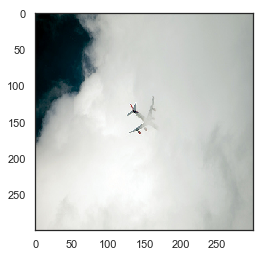

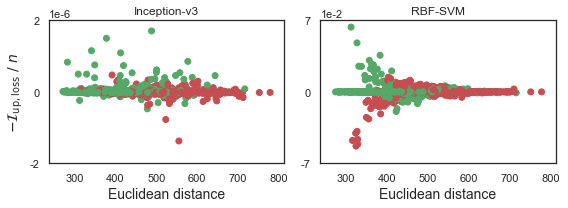

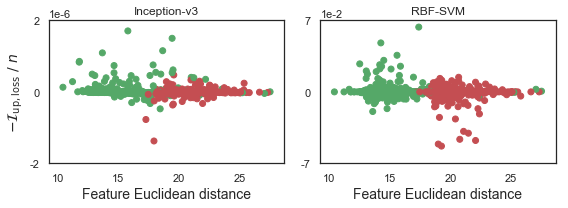

Top from RBF:
1987 1.0 357.39154 0.4670807 0.03091682815551758
1760 1.0 383.71198 0.7475885 0.03587273025512695
433 1.0 327.26608 0.11117394 0.0479983024597168
790 1.0 312.6701 0.83272135 0.06350328826904297
1923 1.0 271.95364 0.57995605 0.1092040557861328


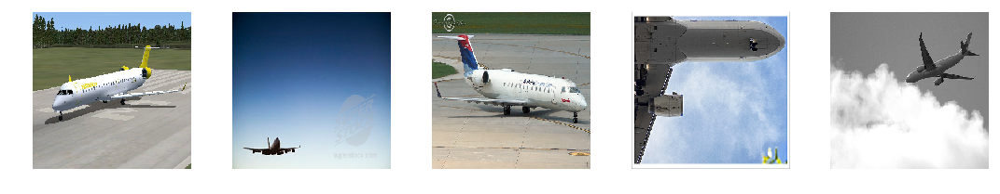

Top from Inception:
567 1.0 412.9053 1.0922832880169153e-06
902 1.0 341.74686 1.1526553425937891e-06
481 1.0 378.32065 1.500008162111044e-06
1992 1.0 488.56357 1.7070388421416284e-06
1853 1.0 314.5946 6.084976717829705e-06


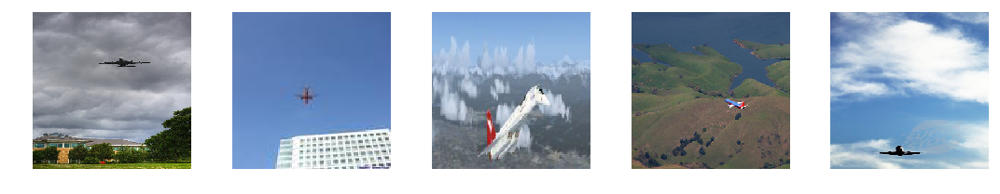

Cars:
15 172 -1.0 392.0744 4.7276625991798937e-07
25 1072 -1.0 480.16333 3.335291985422373e-07
26 1076 -1.0 406.87415 3.325471770949662e-07
27 1171 -1.0 601.981 2.983533777296543e-07
31 382 -1.0 403.6876 2.850431192200631e-07


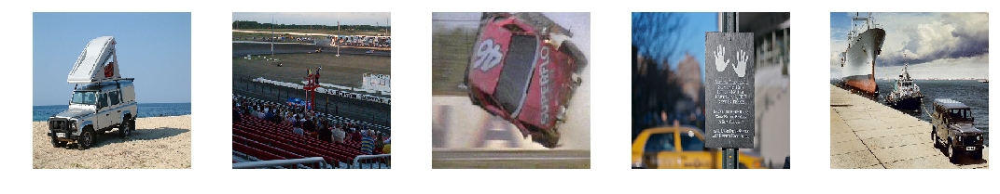

In [49]:
#coding:utf-8
for i in [176]:
    f = np.load('output6/rbf_carair_results_%s.npz' % i)

    test_idx = f['test_idx']
    distances = f['distances']
    flipped_idx = f['flipped_idx']
    rbf_margins_test = f['rbf_margins_test']
    rbf_margins_train = f['rbf_margins_train']
    inception_Y_pred_correct = f['inception_Y_pred_correct']
    rbf_predicted_loss_diffs = f['rbf_predicted_loss_diffs']
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']
    
    print('The test index now is %s. ' % i)
    sns.set_style('white')
    fontsize=14    
    
    print('Test image:')
    print(Y_test[test_idx], rbf_margins_test[test_idx], inception_Y_pred_correct[test_idx])
    #plot_flat_colorimage((X_test[test_idx, :] + 1) / 2, 0, side=299)
    plt.imshow((np.reshape(X_test[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none')
    #plt.savefig('finish/test_176.jpg', dpi=300, bbox_inches='tight')
    
    #画欧几里得距离
    fig, axs = plt.subplots(1, 2, sharex=True, sharey=False, figsize=(8, 3))

    num_train = len(flipped_idx)
    color_vec = np.array(['g'] * num_train)
    color_vec[flipped_idx] = 'r'
    color_vec = list(color_vec)

    axs[0].scatter(distances, inception_predicted_loss_diffs, color=color_vec)
    axs[0].set_ylim(-0.000002, 0.000002)
    axs[0].set_yticks((-0.000002, 0, 0.000002))
    axs[0].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[0].set_title("Inception-v3")
    axs[0].set_xlabel('Euclidean distance', fontsize=fontsize)
    axs[0].set_ylabel('$-\mathcal{I}_\mathrm{up, loss} \ /\ n$', fontsize=fontsize)

    axs[1].scatter(distances, rbf_predicted_loss_diffs, color=color_vec)
    axs[1].set_ylim(-0.07, 0.07)
    axs[1].set_yticks((-0.07, 0, 0.07))
    axs[1].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[1].set_title("RBF-SVM")
    axs[1].set_xlabel('Euclidean distance', fontsize=fontsize)

    plt.tight_layout()
    #plt.savefig('finish/test_176_euclidean_distance.jpg', dpi=300, bbox_inches='tight')
    plt.show()
    
    #画特征值距离
    feature_distances = np.zeros((2000))
    for j in range(2000):
        feature_distances[j] = np.linalg.norm(test_features[i]-train_features[j])
    fig, axs = plt.subplots(1, 2, sharex=True, sharey=False, figsize=(8, 3))

    num_train = len(flipped_idx)
    color_vec = np.array(['g'] * num_train)
    color_vec[flipped_idx] = 'r'
    color_vec = list(color_vec)

    axs[0].scatter(feature_distances, inception_predicted_loss_diffs, color=color_vec)
    axs[0].set_ylim(-0.000002, 0.000002)
    axs[0].set_yticks((-0.000002, 0, 0.000002))
    axs[0].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[0].set_title("Inception-v3")
    axs[0].set_xlabel('Feature Euclidean distance', fontsize=fontsize)
    axs[0].set_ylabel('$-\mathcal{I}_\mathrm{up, loss} \ /\ n$', fontsize=fontsize)

    axs[1].scatter(feature_distances, rbf_predicted_loss_diffs, color=color_vec)
    axs[1].set_ylim(-0.07, 0.07)
    axs[1].set_yticks((-0.07, 0, 0.07))
    axs[1].ticklabel_format(style='sci', scilimits=(0,0), axis='y')
    axs[1].set_title("RBF-SVM")
    axs[1].set_xlabel('Feature Euclidean distance', fontsize=fontsize)
    
    plt.tight_layout()
    #plt.savefig('finish/test_176_feature_distance.jpg', dpi=300, bbox_inches='tight')
    plt.show()
    
    print('Top from RBF:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(rbf_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], rbf_margins_train[train_idx], rbf_predicted_loss_diffs[train_idx])
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    #plt.savefig('finish/test_176_top_rbf.jpg', dpi=300, bbox_inches='tight')
    plt.show()

    print('Top from Inception:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.savefig('finish/test_176_top_inception.jpg', dpi=300, bbox_inches='tight')
    plt.show()
    
    print('Cars:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    counter = 4
    for i, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[:-50:-1]):
        if Y_train[train_idx] == -1.0:
            print(i, train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
            x_train = X_train[train_idx, :]
            axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
            axs[counter].axis('off')
            counter -= 1
        if counter == -1:
            break
    plt.tight_layout()
    plt.savefig('finish/test_176_top_inception_cars.jpg', dpi=300, bbox_inches='tight')
    plt.show()

In [5]:
from scipy import stats

Test image:
136 1.0 0.9998941421508789


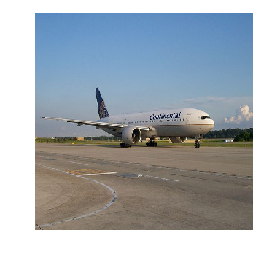

Influence value box plot:
DescribeResult(nobs=2000, minmax=(-2.369228284806013e-06, 2.447811421006918e-06), mean=4.839661983170541e-12, variance=3.339484088493329e-14, skewness=2.131792871792161, kurtosis=69.3755779001683) median=-3.1095285521587354e-08
Test image:
16 1.0 0.9998960494995117


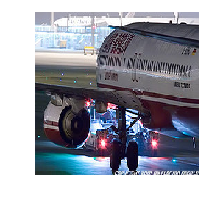

Influence value box plot:
DescribeResult(nobs=2000, minmax=(-4.078687634319067e-06, 5.898516159504652e-06), mean=6.0179112892927634e-12, variance=9.299817825112942e-14, skewness=4.946898579410974, kurtosis=137.65414478614048) median=-2.9696462661377154e-08
Test image:
402 1.0 0.999904990196228


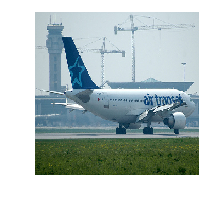

Influence value box plot:
DescribeResult(nobs=2000, minmax=(-1.4185101026669144e-06, 4.864678718149662e-06), mean=6.0871470282115944e-12, variance=3.5959284554794107e-14, skewness=9.956761749831662, kurtosis=238.56507626803247) median=-2.627109188324539e-08


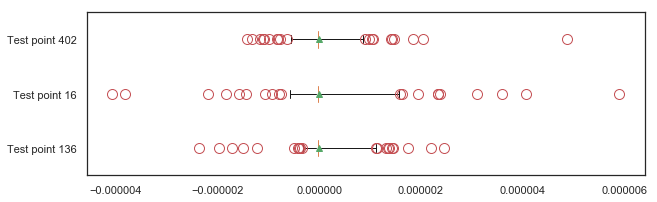

In [24]:
influence_important=[]
for i in [136, 16, 402]:
    f = np.load('output6/rbf_carair_results_%s.npz' % i)
    test_idx = f['test_idx']
    inception_Y_pred_correct = f['inception_Y_pred_correct']
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']
    
    sns.set_style('white')
    fontsize=14
    
    print('Test image:')
    print(test_idx, Y_test[test_idx], inception_Y_pred_correct[test_idx])
    plt.axis('off')
    plt.imshow((np.reshape(X_test[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none', )
    #plt.savefig('finish/adver_%s.jpg' % i, dpi=300, bbox_inches='tight')
    plt.show()
    
    print('Influence value box plot:')
    plt.figure(figsize=(10,3))
    influence_important.append(inception_predicted_loss_diffs)
    #influence_important = inception_predicted_loss_diffs[np.abs(inception_predicted_loss_diffs)>0.002]
    print(stats.describe(inception_predicted_loss_diffs), 'median=%s' % np.median(inception_predicted_loss_diffs))

labels=['Test point 136', 'Test point 16', 'Test point 402']
flierprops = dict(marker='o',  markersize=10,
                  linestyle='none', markeredgecolor='r')
plt.boxplot(influence_important,
            labels=labels,
            vert=False,
            whis=[0.5, 99.5],
            #notch=True,
            showmeans=True,
            showbox=False,
            flierprops=flierprops)
plt.savefig('finish/adver_boxplot_ori.jpg', dpi=300, bbox_inches='tight')

Test image:
324 -1.0 0.996356725692749


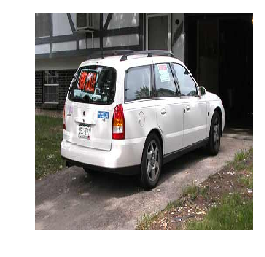

Top from Inception:
1519 -1.0 390.57642 7.25274458527565e-05
591 -1.0 437.18713 8.618403226137161e-05
1907 -1.0 436.40088 0.00010554751753807068
1375 -1.0 375.48138 0.00014412763714790345
887 -1.0 381.5531 0.0003619565963745117


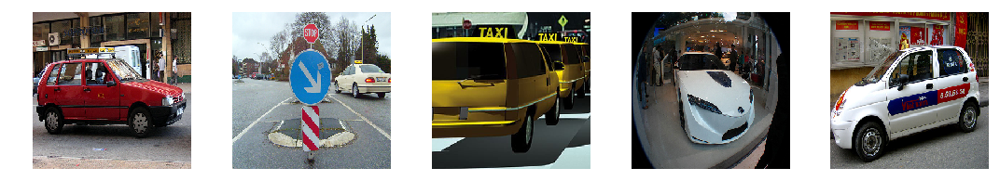

In [4]:
for i in [324]:
    f = np.load('output6/rbf_carair_results_%s.npz' % i)
    test_idx = f['test_idx']
    inception_Y_pred_correct = f['inception_Y_pred_correct']
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']
    distances = f['distances']
    
    sns.set_style('white')
    fontsize=14
    
    print('Test image:')
    print(test_idx, Y_test[test_idx], inception_Y_pred_correct[test_idx])
    plt.axis('off')
    plt.imshow((np.reshape(X_test[test_idx, :], [299, 299, 3]) + 1) / 2, interpolation='none', )
    plt.savefig('finish/test_%s.jpg' % i, dpi=300, bbox_inches='tight')
    plt.show()
    
    print('Top from Inception:')
    fig, axs = plt.subplots(1, 5, figsize=(15,3))
    for counter, train_idx in enumerate(np.argsort(inception_predicted_loss_diffs)[-5:]):
        print(train_idx, Y_train[train_idx], distances[train_idx], inception_predicted_loss_diffs[train_idx])    
        x_train = X_train[train_idx, :]
        axs[counter].imshow((np.reshape(x_train, [299, 299, 3]) + 1) / 2, interpolation='none')  
        axs[counter].axis('off')
    plt.tight_layout()
    plt.savefig('finish/test_%s_top_inception.jpg' % i, dpi=300, bbox_inches='tight')
    plt.show()

In [5]:
np.argsort(inception_predicted_loss_diffs)[-2:]

array([1375,  887], dtype=int64)

In [13]:
#整理一下每一个测试点top2训练点的index
top2index = np.zeros((600, 2))
for i in range(600):
    f = np.load('output6/rbf_carair_results_%s.npz' % i)
    inception_predicted_loss_diffs = f['inception_predicted_loss_diffs']
    
    top2index[i] = np.argsort(inception_predicted_loss_diffs)[-2:]

In [8]:
top2index.astype(np.uint16)

array([[1992, 1654],
       [ 557,   75],
       [ 172,  557],
       ...,
       [1681, 1321],
       [1321, 1375],
       [1321,  887]], dtype=uint16)

In [ ]:
np.savez('output6/top2index', top2index=top2index)

In [2]:
import numpy as np

In [9]:
top2ori=np.load('output6/top2index.npz')['top2index']
top2bright=np.load('output18/top2index.npz')['top2index']
top2dark=np.load('output19/top2index.npz')['top2index']

In [10]:
count1 = 0
count2 = 0
for i in range(600):
    if top2ori[i][0] in top2bright[i] or top2ori[i][1] in top2bright[i]:
        count1+=1
print(count1)
#top1=330 top2=157
#top1 or top2=501

542
